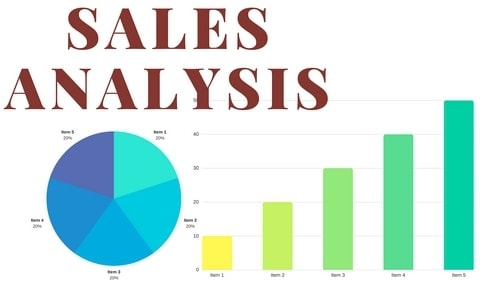

<font size="+4" color="#00008B"><h1>Walmart Sales Forecast</h1></font>
<font size="+2" color="#00008B"><h3>Capstone Project</h3></font>

#### By: Onkar Bhise

<font color="#A020F0"><h1>Problem Statement:</h1></font>

1. You are provided with the weekly sales data for their various outlets. Use statistical analysis, EDA, outlier analysis, and handle the missing values to come up with various insights that can give them a clear perspective on the following:
- If the weekly sales are affected by the unemployment rate, if yes - which stores are suffering the most?
- If the weekly sales show a seasonal trend, when and what could be the reason?
- Does temperature affect the weekly sales in any manner?
- How is the Consumer Price index affecting the weekly sales of various stores?
- Top performing stores according to the historical data.
- The worst performing store, and how significant is the difference between the highest and lowest performing stores.
2. Use predictive modeling techniques to forecast the sales for each store for the next 12 weeks.


<font color="#A020F0"><h2>Dataset Information:</h2></font>


| Feature Name   | Description                                       |
|----------------|---------------------------------------------------|
| Store          | Store number                                      |
| Date           | Week of Sales                                     |
| Weekly_Sales   | Sales for the given store in that week             |
| Holiday_Flag   | Indicator if it is a holiday week                  |
| Temperature    | Temperature on the day of the sale                 |
| Fuel_Price     | Cost of the fuel in the region                     |
| CPI            | Consumer Price Index                               |
| Unemployment   | Unemployment Rate                                  |


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pmdarima.arima import auto_arima
import pmdarima as pm
from pmdarima.datasets import load_wineind
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
from prophet.diagnostics import cross_validation
from prophet.diagnostics import performance_metrics
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error
from statsmodels.tsa.stattools import adfuller
from prophet import Prophet
from statsmodels.tsa.holtwinters import ExponentialSmoothing

In [2]:
import logging
import warnings
logging.disable(logging.CRITICAL)
warnings.filterwarnings("ignore")

In [3]:
walmart_data = pd.read_csv("Walmart.csv")

In [4]:
walmart_data.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,05-02-2010,1643690.90,0,42.31,2.572,211.096358,8.106
1,1,12-02-2010,1641957.44,1,38.51,2.548,211.242170,8.106
2,1,19-02-2010,1611968.17,0,39.93,2.514,211.289143,8.106
3,1,26-02-2010,1409727.59,0,46.63,2.561,211.319643,8.106
4,1,05-03-2010,1554806.68,0,46.50,2.625,211.350143,8.106


<font color="#A020F0"><h2>Data Preprocessing:</h2></font>
- Data preprocessing is a vital stage in data analysis where raw data is transformed, cleaned, and organized to enhance its quality for further analysis.
- This step ensures that the data is accurate, complete, and appropriately formatted, setting the foundation for more effective and reliable analysis and modeling.

In [5]:
walmart_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6435 entries, 0 to 6434
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         6435 non-null   int64  
 1   Date          6435 non-null   object 
 2   Weekly_Sales  6435 non-null   float64
 3   Holiday_Flag  6435 non-null   int64  
 4   Temperature   6435 non-null   float64
 5   Fuel_Price    6435 non-null   float64
 6   CPI           6435 non-null   float64
 7   Unemployment  6435 non-null   float64
dtypes: float64(5), int64(2), object(1)
memory usage: 402.3+ KB


In [6]:
#Cheacking Null Values
walmart_data.isnull().sum()

Store           0
Date            0
Weekly_Sales    0
Holiday_Flag    0
Temperature     0
Fuel_Price      0
CPI             0
Unemployment    0
dtype: int64

In [7]:
duplicated_records_count = walmart_data.duplicated().sum()
print("Number of duplicated records:", duplicated_records_count)

Number of duplicated records: 0


<font color="#A020F0"><h2>Feature Engineering:</h2></font>
- Feature engineering is the process of creating new features or transforming existing features in a dataset to improve the performance of machine learning models.
- This involves selecting, modifying, or creating new variables (features) from the raw data that can help the model better understand the underlying patterns and relationships in the data.
1. Extracting Day, Month, Hour, month name and day name from InvoiceDate.

In [8]:
walmart_data['Date'] = pd.to_datetime(walmart_data['Date'], format = '%d-%m-%Y')

In [9]:
#Extracting Year, Month, Week from Date column and saving in new seprate columns
walmart_data['Year'] = walmart_data['Date'].dt.year
walmart_data['Month'] = walmart_data['Date'].dt.month
walmart_data['Day'] = walmart_data['Date'].dt.day
walmart_data['Week'] = walmart_data['Date'].dt.isocalendar().week

In [10]:
walmart_data.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Year,Month,Day,Week
0,1,2010-02-05,1643690.90,0,42.31,2.572,211.096358,8.106,2010,2,5,5
1,1,2010-02-12,1641957.44,1,38.51,2.548,211.242170,8.106,2010,2,12,6
2,1,2010-02-19,1611968.17,0,39.93,2.514,211.289143,8.106,2010,2,19,7
3,1,2010-02-26,1409727.59,0,46.63,2.561,211.319643,8.106,2010,2,26,8
4,1,2010-03-05,1554806.68,0,46.50,2.625,211.350143,8.106,2010,3,5,9


In [11]:
walmart_data['Holiday_Flag'] = walmart_data['Holiday_Flag'].astype('category')
walmart_data['Store'] = walmart_data['Store'].astype('category')

In [12]:
walmart_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6435 entries, 0 to 6434
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Store         6435 non-null   category      
 1   Date          6435 non-null   datetime64[ns]
 2   Weekly_Sales  6435 non-null   float64       
 3   Holiday_Flag  6435 non-null   category      
 4   Temperature   6435 non-null   float64       
 5   Fuel_Price    6435 non-null   float64       
 6   CPI           6435 non-null   float64       
 7   Unemployment  6435 non-null   float64       
 8   Year          6435 non-null   int64         
 9   Month         6435 non-null   int64         
 10  Day           6435 non-null   int64         
 11  Week          6435 non-null   UInt32        
dtypes: UInt32(1), category(2), datetime64[ns](1), float64(5), int64(3)
memory usage: 498.1 KB


In [13]:
walmart_data.describe()

,Weekly_Sales,Temperature,Fuel_Price,CPI,Unemployment,Year,Month,Day,Week
count,6.435000e+03,6435.000000,6435.000000,6435.000000,6435.000000,6435.000000,6435.000000,6435.000000,6435.0
mean,1.046965e+06,60.663782,3.358607,171.578394,7.999151,2010.965035,6.447552,15.678322,25.818182
std,5.643666e+05,18.444933,0.459020,39.356712,1.875885,0.797019,3.238308,8.755780,14.129201
min,2.099862e+05,-2.060000,2.472000,126.064000,3.879000,2010.000000,1.000000,1.000000,1.0
25%,5.533501e+05,47.460000,2.933000,131.735000,6.891000,2010.000000,4.000000,8.000000,14.0
50%,9.607460e+05,62.670000,3.445000,182.616521,7.874000,2011.000000,6.000000,16.000000,26.0
75%,1.420159e+06,74.940000,3.735000,212.743293,8.622000,2012.000000,9.000000,23.000000,38.0
max,3.818686e+06,100.140000,4.468000,227.232807,14.313000,2012.000000,12.000000,31.000000,52.0


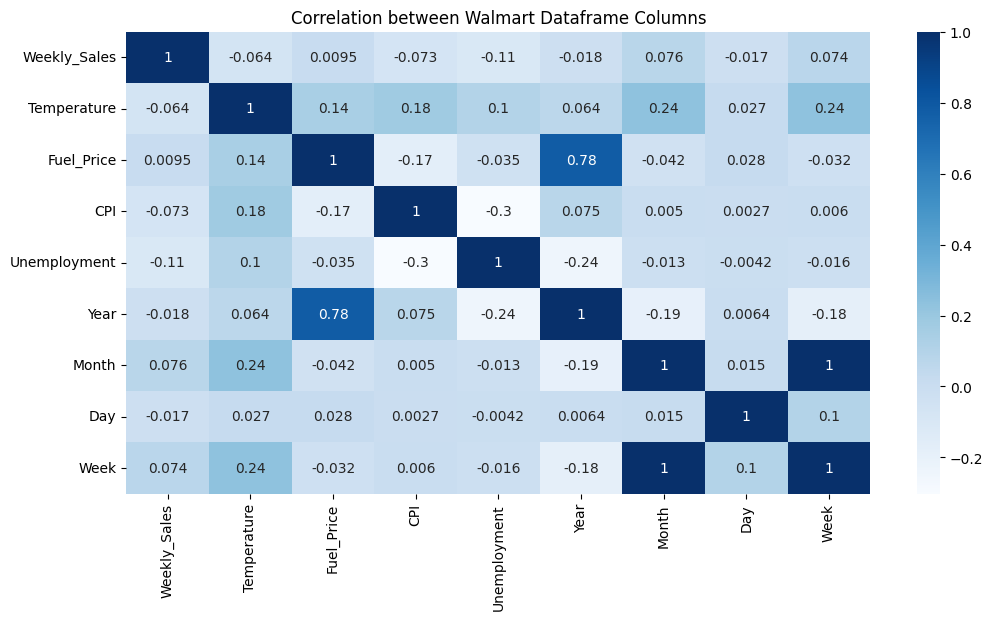

In [14]:
plt.figure(figsize = (12,6))
temp1 = walmart_data.drop(columns = ['Date', 'Store'])
sns.heatmap(temp1.corr(), annot = True, cmap ='Blues')
plt.title("Correlation between Walmart Dataframe Columns")
plt.show()

## Outliers Detection, Analysis and treatment if requried

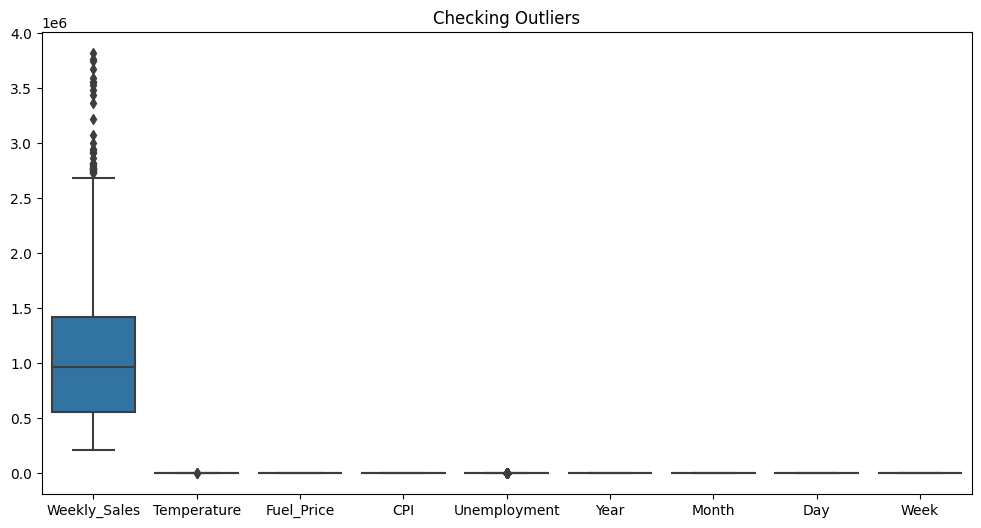

In [15]:
plt.figure(figsize = (12,6))
sns.boxplot(data = walmart_data)
plt.title("Checking Outliers")
plt.show()

- Weekly_sales columns has outliers, Checking values before deleting.

In [16]:
q1 = walmart_data['Weekly_Sales'].quantile(0.25)
q3 = walmart_data['Weekly_Sales'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - (1.5 * iqr)
upper_bound = q3 + (1.5 * iqr)

In [17]:
#Saving outliers in new dataframe and checking values before deleting
weekly_sales_outliers = walmart_data[(walmart_data['Weekly_Sales'] < lower_bound) | (walmart_data['Weekly_Sales'] > upper_bound)]

In [18]:
weekly_sales_outliers

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Year,Month,Day,Week
189,2,2010-12-24,3436007.68,0,49.97,2.886,211.064660,8.163,2010,12,24,51
241,2,2011-12-23,3224369.80,0,46.66,3.112,218.999550,7.441,2011,12,23,51
471,4,2010-11-26,2789469.45,1,48.08,2.752,126.669267,7.127,2010,11,26,47
474,4,2010-12-17,2740057.14,0,46.57,2.884,126.879484,7.127,2010,12,17,50
475,4,2010-12-24,3526713.39,0,43.21,2.887,126.983581,7.127,2010,12,24,51
523,4,2011-11-25,3004702.33,1,47.96,3.225,129.836400,5.143,2011,11,25,47
526,4,2011-12-16,2771397.17,0,36.44,3.149,129.898065,5.143,2011,12,16,50
527,4,2011-12-23,3676388.98,0,35.92,3.103,129.984548,5.143,2011,12,23,51
761,6,2010-12-24,2727575.18,0,55.07,2.886,212.916508,7.007,2010,12,24,51
1329,10,2010-11-26,2939946.38,1,55.33,3.162,126.669267,9.003,2010,11,26,47


#### In the retail industry, certain periods witness heightened sales, which may not necessarily be outliers but rather expected peaks in consumer activity.
#### Holiday Peaks in Retail Sales:
- Specifically around Thanksgiving (November 25th and 26th) and the run-up to Christmas (December 10th, 16th, 17th, 23rd, and 24th), notable surges in retail sales occur. These periods coincide with events like Black Friday and the heightened shopping season preceding Christmas. During this time, retailers often implement special promotions or sales events to captivate the surge in consumer demand leading up to the festive season.

#### Anticipated peak values:
- These occurrences are integral parts of the retail calendar, representing anticipated peaks in sales rather than statistical outliers.
- Recognizing these busy times during holiday shopping is really important when looking at sales numbers. It helps us understand the data better and make sense of how people shop during these special times.

### If the weekly sales are affected by the unemployment rate, if yes - which stores are suffering the most?

In [19]:
correlations = pd.DataFrame(columns=['Store', 'Correlation'])

for store in walmart_data['Store'].unique():
    store_data = walmart_data[walmart_data['Store'] == store]
    correlation = store_data['Weekly_Sales'].corr(store_data['Unemployment'])
    correlations = correlations.append({'Store': store, 'Correlation': correlation}, ignore_index=True)

In [20]:
correlations

,Store,Correlation
0,1.0,-0.097955
1,2.0,0.066325
2,3.0,-0.230413
3,4.0,-0.337015
4,5.0,-0.207043
5,6.0,0.044251
6,7.0,-0.165382
7,8.0,-0.052580
8,9.0,-0.191534
9,10.0,0.131908


In [21]:
## Finding which stores are affected mostly by unemployment rate.
affected_stores = walmart_data.groupby('Store')[['Weekly_Sales', 'Unemployment']].corr().iloc[0::2,-1]

In [22]:
affected_stores = affected_stores.to_frame().reset_index()

In [23]:
affected_stores.head()

,Store,level_1,Unemployment
0,1,Weekly_Sales,-0.097955
1,2,Weekly_Sales,0.066325
2,3,Weekly_Sales,-0.230413
3,4,Weekly_Sales,-0.337015
4,5,Weekly_Sales,-0.207043


In [24]:
min_corr = affected_stores['Unemployment'].min()
filt = (affected_stores['Unemployment'] == min_corr)
store = affected_stores.loc[filt, 'Store']
print("Stores with the Highest Negative Correlation with Unemployment Rate:", store.iloc[0])

Stores with the Highest Negative Correlation with Unemployment Rate: 38


In [25]:
top_affected_stores = affected_stores.sort_values(by='Unemployment').head(5)
print("Top 5 Stores Most Affected by Unemployment Rate:")
print(top_affected_stores[['Store', 'Unemployment']])

Top 5 Stores Most Affected by Unemployment Rate:
   Store  Unemployment
37    38     -0.785290
43    44     -0.780076
38    39     -0.384681
41    42     -0.356355
40    41     -0.350630


- The correlation values indicate the relationship between weekly sales and unemployment. Negative correlations suggest an inverse relationship, implying that as unemployment increases, weekly sales decrease, and vice versa. Therefore, stores with higher negative correlation values are likely more affected by changes in unemployment.

- Stores with higher negative correlation values, such as Store 38 (-0.785), Store 43 (-0.202), and Store 44 (-0.780), indicate a stronger inverse relationship between unemployment and weekly sales. These stores might be more significantly impacted by changes in unemployment rates.

- Store 38, for instance, has a notably high negative correlation, suggesting that it could be more sensitive to changes in unemployment rates compared to other stores in your dataset. These stores could potentially suffer more in terms of weekly sales when unemployment rates increase.

### If the weekly sales show a seasonal trend, when and what could be the reason?

In [26]:
holiday_sales = walmart_data[walmart_data['Holiday_Flag'] == 1]['Weekly_Sales'].mean()
non_holiday_sales = walmart_data[walmart_data['Holiday_Flag'] == 0]['Weekly_Sales'].mean()
print("Average Sales During Holidays:", holiday_sales)
print("Average Sales During Non-Holidays:", non_holiday_sales)

Average Sales During Holidays: 1122887.8923555557
Average Sales During Non-Holidays: 1041256.3802088555


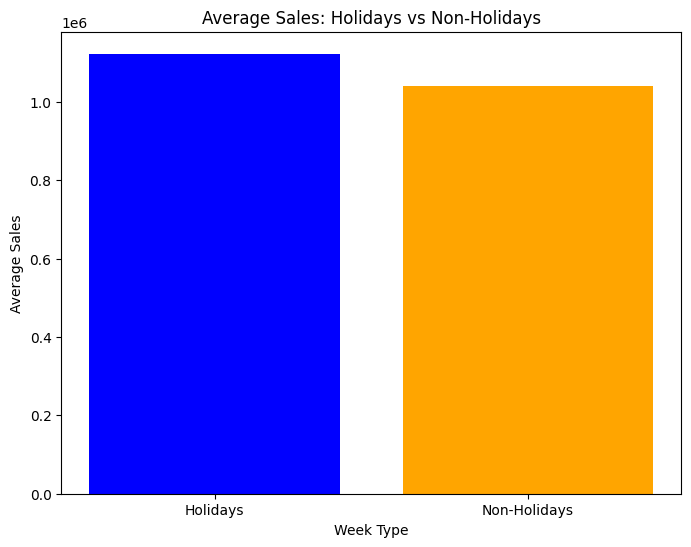

In [27]:
plt.figure(figsize=(8, 6))
plt.bar(['Holidays', 'Non-Holidays'], [holiday_sales, non_holiday_sales], color=['blue', 'orange'])
plt.title('Average Sales: Holidays vs Non-Holidays')
plt.xlabel('Week Type')
plt.ylabel('Average Sales')
plt.show()

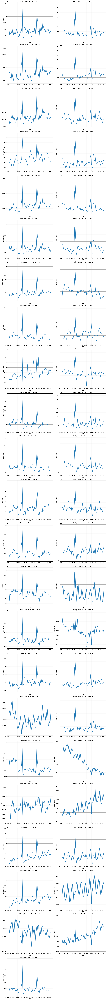

In [28]:
num_plots = len(walmart_data['Store'].unique())
num_cols = 2  # Number of columns for subplots
num_rows = (num_plots + 1) // num_cols  # Calculate the number of rows needed

fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 6*num_rows))

for i, store in enumerate(walmart_data['Store'].unique()):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col]
    
    store_data = walmart_data[walmart_data['Store'] == store]
    
    ax.plot(store_data['Date'], store_data['Weekly_Sales'], linestyle='-')
    ax.set_title(f'Weekly Sales Over Time - Store {store}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Weekly Sales')
    ax.grid(True)

# Hide empty subplots if the number of stores doesn't fill all the cells
if num_plots % num_cols != 0:
    for i in range(num_plots, num_rows * num_cols):
        axs.flat[i].axis('off')

plt.tight_layout()
plt.show()


#### Conclusion:
- Almost all stores shows seasonality except 28,30,33,36,37,38,42,43.
- The weekly sales go in November and December every year.
- We'll analyze it more in further analysis.

### Does temperature affect the weekly sales in any manner?

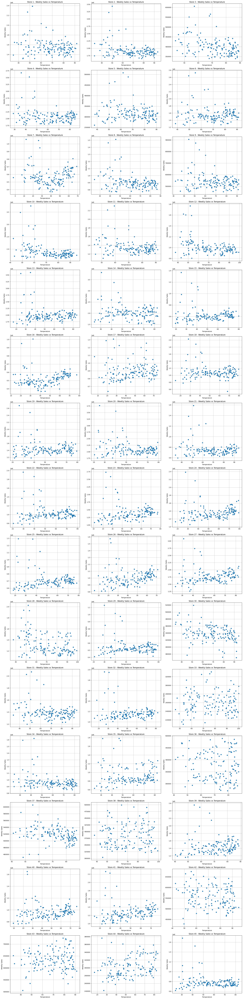

In [29]:
num_plots = len(walmart_data['Store'].unique())
num_cols = 3  # Number of columns for subplots
num_rows = (num_plots + 2) // num_cols  # Calculate the number of rows needed

fig, axs = plt.subplots(num_rows, num_cols, figsize=(22, 6*num_rows))

for i, store in enumerate(walmart_data['Store'].unique()):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col]
    
    store_data = walmart_data[walmart_data['Store'] == store]
    
    ax.scatter(store_data['Temperature'], store_data['Weekly_Sales'])
    ax.set_title(f'Store {store} - Weekly Sales vs Temperature')
    ax.set_xlabel('Temperature')
    ax.set_ylabel('Weekly Sales')
    ax.grid(True)

# Hide empty subplots if the number of stores doesn't fill all the cells
if num_plots % num_cols != 0:
    for i in range(num_plots, num_rows * num_cols):
        axs.flat[i].axis('off')

plt.tight_layout()
plt.show()

#### Conclusion:
- From above graphs we can that as temperature increases or decreases, there's only a slight impact (if any) on weekly sales.
- The correlation is not strong enough to confidently assert that temperature has a substantial effect on weekly sales in these data.

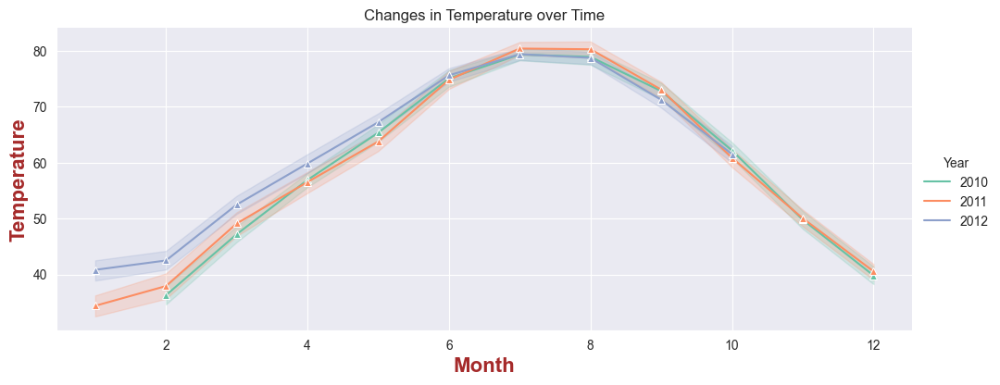

In [30]:
sns.set_style('darkgrid')
sns.relplot(data = walmart_data,x = 'Month',y = 'Temperature',hue='Year', kind = 'line',height = 4,aspect=2.5,palette='Set2', marker ='^')
plt.title('Changes in Temperature over Time')
plt.xlabel('Month', color='brown',fontweight='bold', fontsize=16)
plt.ylabel('Temperature', color='brown',fontweight='bold', fontsize=16)
plt.show()

## How is the Consumer Price index affecting the weekly sales of various stores?

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

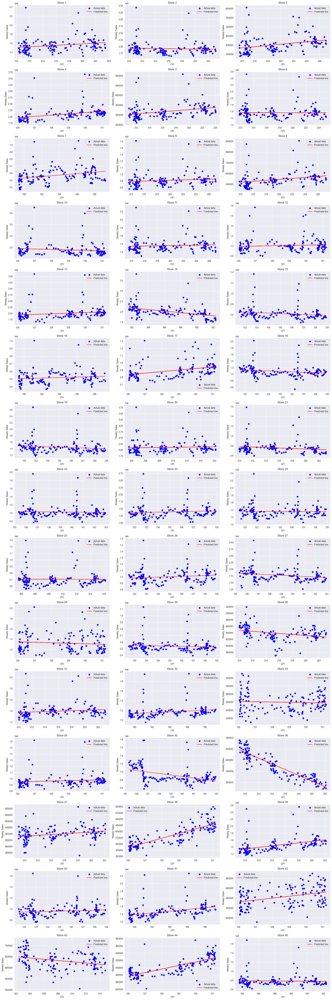

In [31]:
grouped_stores = walmart_data.groupby('Store')

num_rows = 15
num_cols = 3
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 60))
axs = axs.flatten()

for idx, (store_id, data) in enumerate(grouped_stores):
    sales_cpi_data = data[['Weekly_Sales', 'CPI']]
    X = sales_cpi_data[['CPI']]
    y = sales_cpi_data['Weekly_Sales']
    model = LinearRegression()
    model.fit(X, y)
    ax = axs[idx]
    ax.scatter(X, y, color='blue', label='Actual data')
    ax.plot(X, model.predict(X), color='red', label='Predicted line')
    ax.set_title(f"Store {store_id}")
    ax.set_xlabel('CPI')
    ax.set_ylabel('Weekly Sales')
    ax.legend()

for i in range(len(grouped_stores), num_rows * num_cols):
    axs[i].axis('off')

plt.tight_layout()
plt.show()

**Stores with Positive CPI Coefficients:**

1.  These stores show an increase in weekly sales with an increase in CPI.
2.  Stores like 1, 3, 5, 7, 8, 9, 11, 12, 13, 16, 23, 26, 31, 34, 37, 40, 43, and 45 have positive coefficients for CPI, suggesting that as the Consumer Price Index rises, these stores tend to experience higher weekly sales.


**Stores with Negative CPI Coefficients:**

1. These stores exhibit a decrease in weekly sales as the CPI increases.
2. Stores like 2, 4, 6, 10, 14, 15, 17, 18, 19, 20, 21, 22, 24, 25, 27, 28, 29, 30, 32, 33, 35, 36, 38, 39, 41, 42, and 44 have negative coefficients for CPI, indicating that their sales tend to decrease as the Consumer Price Index goes up.


**Interpretation:**

1. Stores with positive coefficients may be more aligned with consumer behavior where higher CPI implies more spending capacity or an increased willingness to purchase.
2. Stores with negative coefficients might cater to products or demographics that are more sensitive to price changes, so an increase in CPI might deter their sales due to reduced purchasing power or consumer preferences shifting towards cheaper alternatives.

This analysis suggests that the impact of CPI on weekly sales varies among stores, indicating different consumer behaviors, product categories, or market segments that respond differently to changes in the Consumer Price Index.







# Top performing stores according to the historical data

Top performing stores by Total Sales:

In [32]:
total_sales_per_store = walmart_data.groupby('Store')['Weekly_Sales'].sum()
top_stores_by_total_sales = total_sales_per_store.sort_values(ascending = False)
print("Top performing Stores by Sales:")
top_stores_by_total_sales.head(10)

Top performing Stores by Sales:


Store
20    3.013978e+08
4     2.995440e+08
14    2.889999e+08
13    2.865177e+08
2     2.753824e+08
10    2.716177e+08
27    2.538559e+08
6     2.237561e+08
1     2.224028e+08
39    2.074455e+08
Name: Weekly_Sales, dtype: float64

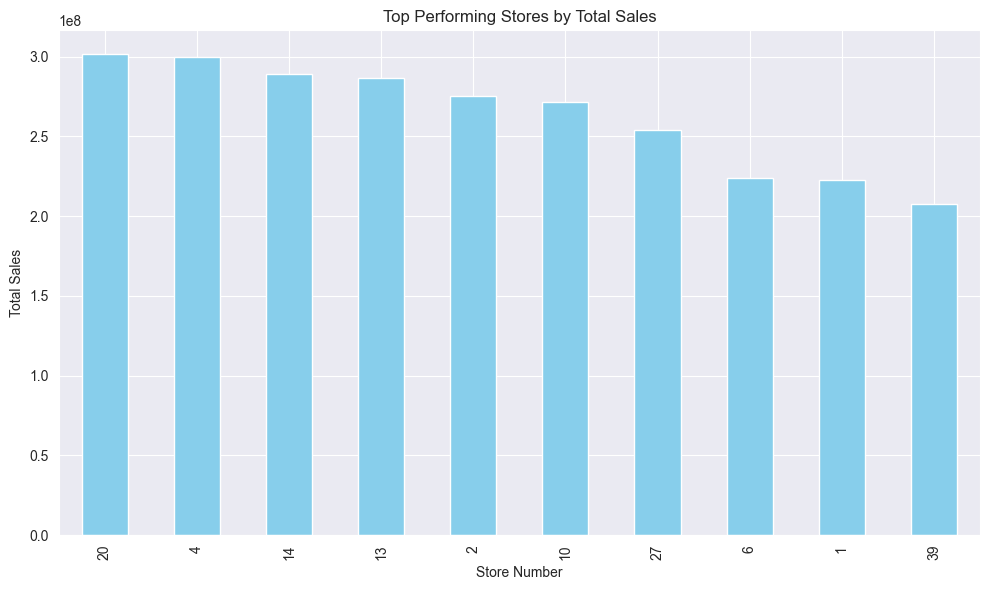

In [33]:
top_stores_by_total_sales = total_sales_per_store.sort_values(ascending=False).head(10)
plt.figure(figsize=(10, 6))
top_stores_by_total_sales.plot(kind='bar', color='skyblue')
plt.title('Top Performing Stores by Total Sales')
plt.xlabel('Store Number')
plt.ylabel('Total Sales')
plt.tight_layout()
plt.show()

The worst performing store, and how significant is the difference between the highest and lowest performing stores

In [34]:
total_sales_per_store = walmart_data.groupby('Store')['Weekly_Sales'].sum()
worst_store_total_sales = total_sales_per_store.idxmin()
min_sales_value = total_sales_per_store.min()
print(f"Worst Performing Store by Total Sales: Store {worst_store_total_sales} with total sales of {min_sales_value}")
best_store_total_sales = total_sales_per_store.idxmax()
max_sales_value = total_sales_per_store.max()
print(f"Best Performing Store by Total Sales: Store {best_store_total_sales} with total sales of {max_sales_value}")

Worst Performing Store by Total Sales: Store 33 with total sales of 37160221.96
Best Performing Store by Total Sales: Store 20 with total sales of 301397792.46


In [35]:
difference_highest_lowest = total_sales_per_store.max() - total_sales_per_store.min()
print(f"Difference between Highest and Lowest Total Sales: {difference_highest_lowest}")

Difference between Highest and Lowest Total Sales: 264237570.49999997


In [36]:
total_sales_yearly_store = walmart_data.groupby(['Year', 'Store'])['Weekly_Sales'].sum().reset_index()
worst_stores_by_year = total_sales_yearly_store.loc[total_sales_yearly_store.groupby('Year')['Weekly_Sales'].idxmin()]

print("Worst Performing Store by Year:")
print(worst_stores_by_year)

Worst Performing Store by Year:
     Year Store  Weekly_Sales
32   2010    33   12766834.26
77   2011    33   12957836.67
122  2012    33   11435551.03


<font color="#A020F0"><h2>Use predictive modeling techniques to forecast the sales for each store for the next 12 weeks.:</h2></font>
- **When it comes to forecasting based on historical data, there are several factors to consider. In this case, the goal is to predict the upcoming 12 weeks using historical data. However, there's a challenge as the data for certain variables like Holiday_flag, temperature, Fuel_price, CPI, and Unemployment for these upcoming weeks is unavailable.**

- **To address this issue and ensure the accuracy of our forecasting model, we have to make adjustments. Since we lack these crucial variables for the upcoming weeks, we cannot factor them into our predictions. Therefore, the best approach is to exclude these variables from our model building process.**

- **After excluding them, we remain with the Date and Weekly Sales.  Our strategy involves utilizing time series forecasting models such as ARIMA-SARIMA, FBprophet, and ExponentialSmoothing to forecast sales for the next 12 weeks.**

#### SARIMA (Seasonal ARIMA):
- SARIMA extends the ARIMA model to account for seasonality in the data.
- It's suitable for datasets that exhibit seasonal patterns.
- By incorporating seasonal differencing, it addresses variations that occur regularly over specific intervals.

#### FBprophet (Facebook Prophet):
- FBprophet is designed to handle time series data with various components like seasonality, holidays, and trend changes.
- It's user-friendly and can automatically detect and incorporate multiple seasonalities.
- Prophet can handle missing data and outliers effectively.

#### Exponential Smoothing:
- This method models the time series data by assigning exponentially decreasing weights to past observations.
- It's useful for capturing trends and seasonality in the data.
- Exponential smoothing methods, like Holt-Winters, adaptively update forecasts based on recent observations.

**Choosing a combination of these methods allows for a comprehensive exploration of different forecasting techniques. ARIMA and SARIMA are strong choices for handling linear patterns and seasonal variations, while FBprophet offers flexibility in dealing with multiple seasonalities and holidays. Exponential Smoothing provides a simpler yet effective approach for capturing trends and seasonality.**

In [37]:
walmart_df = walmart_data.copy()
walmart_df.drop(columns = ['Holiday_Flag','Temperature','Fuel_Price','CPI','Unemployment','Year','Month','Day','Week'], inplace = True)
walmart_df['Log_Weekly_Sales'] = np.log(walmart_df['Weekly_Sales'])

In [38]:
walmart_df.head()

,Store,Date,Weekly_Sales,Log_Weekly_Sales
0,1,2010-02-05,1643690.90,14.312455
1,1,2010-02-12,1641957.44,14.311400
2,1,2010-02-19,1611968.17,14.292966
3,1,2010-02-26,1409727.59,14.158907
4,1,2010-03-05,1554806.68,14.256862


In [39]:
store_numbers = walmart_df['Store'].unique()
adf_test_statistic = []
p_values = []
lags_used = []
observations_used = []
stationary_status = []

for store_number in store_numbers:
    test_store = walmart_df[walmart_df['Store'] == store_number]
    result = adfuller(test_store['Weekly_Sales'])
    adf_test_statistic.append(result[0])
    p_values.append(result[1])
    lags_used.append(result[2])
    observations_used.append(result[3])
    
    if result[1] <= 0.05:
        stationary_status.append('Yes')
    else:
        stationary_status.append('No')

result = pd.DataFrame({'Store': store_numbers,'ADF Test Statistic': adf_test_statistic,
    'P-value': p_values,'#Lags Used': lags_used,'Number of Observations Used': observations_used,
    'Stationary': stationary_status})

In [40]:
result

,Store,ADF Test Statistic,P-value,#Lags Used,Number of Observations Used,Stationary
0,1,-5.102186,1.387779e-05,4,138,Yes
1,2,-3.708863,3.990207e-03,6,136,Yes
2,3,-2.963868,3.840926e-02,6,136,Yes
3,4,-2.879382,4.779866e-02,6,136,Yes
4,5,-4.310974,4.251706e-04,4,138,Yes
5,6,-5.492502,2.159486e-06,4,138,Yes
6,7,-4.476254,2.170072e-04,7,135,Yes
7,8,-5.647653,1.002746e-06,4,138,Yes
8,9,-5.008564,2.134309e-05,4,138,Yes
9,10,-5.200703,8.763068e-06,4,138,Yes


In [41]:
non_stationary_stores = result[result['Stationary'] == 'No']['Store'].tolist()
print(non_stationary_stores)

[14, 30, 36, 38, 42, 43, 44]


- Upon examination, it's evident that certain stores have non-stationary data. To address this, we'll employ the differencing method to convert the non-stationary data into a stationary form.
- Also, we'll create different dataframes for stores with stationary data and non stationary data. 

In [42]:
non_stationary_df = walmart_df[walmart_df['Store'].isin(non_stationary_stores)].copy()
walmart_df = walmart_df[~walmart_df['Store'].isin(non_stationary_stores)].copy()

In [43]:
non_stationary_df.isnull().sum()

Store               0
Date                0
Weekly_Sales        0
Log_Weekly_Sales    0
dtype: int64

In [44]:
non_stationary_df.head()

,Store,Date,Weekly_Sales,Log_Weekly_Sales
1859,14,2010-02-05,2623469.95,14.780008
1860,14,2010-02-12,1704218.84,14.348617
1861,14,2010-02-19,2204556.70,14.606037
1862,14,2010-02-26,2095591.63,14.555346
1863,14,2010-03-05,2237544.75,14.620890


In [45]:
non_stationary_df = non_stationary_df.sort_values(by=['Store', 'Date'])
non_stationary_df['Diff_Weekly_Sales'] = non_stationary_df.groupby('Store')['Weekly_Sales'].diff()
non_stationary_df.drop(columns=['Log_Weekly_Sales'], axis = 1, inplace = True)

In [46]:
non_stationary_df.head()

,Store,Date,Weekly_Sales,Diff_Weekly_Sales
1859,14,2010-02-05,2623469.95,NaN
1860,14,2010-02-12,1704218.84,-919251.11
1861,14,2010-02-19,2204556.70,500337.86
1862,14,2010-02-26,2095591.63,-108965.07
1863,14,2010-03-05,2237544.75,141953.12


In [47]:
non_stationary_df.dropna(subset = ['Diff_Weekly_Sales'], inplace = True)

In [48]:
store_numbers = non_stationary_df['Store'].unique()
adf_test_statistic = []
p_values = []
lags_used = []
observations_used = []
stationary_status = []

for store_number in store_numbers:
    test_store = non_stationary_df[non_stationary_df['Store'] == store_number]
    result = adfuller(test_store['Diff_Weekly_Sales'])
    
    adf_test_statistic.append(result[0])
    p_values.append(result[1])
    lags_used.append(result[2])
    observations_used.append(result[3])
    
    if result[1] <= 0.05:
        stationary_status.append('Yes')
    else:
        stationary_status.append('No')

# Creating the 'result' dataframe
result = pd.DataFrame({'Store': store_numbers, 'ADF Test Statistic': adf_test_statistic,
    'P-value': p_values,'#Lags Used': lags_used,'Number of Observations Used': observations_used,'Stationary': stationary_status})

In [49]:
result

,Store,ADF Test Statistic,P-value,#Lags Used,Number of Observations Used,Stationary
0,14,-7.381184,8.464372e-11,5,136,Yes
1,30,-7.187476,2.554473e-10,5,136,Yes
2,36,-4.152939,7.907591e-04,9,132,Yes
3,38,-4.781426,5.901459e-05,11,130,Yes
4,42,-4.098051,9.757356e-04,11,130,Yes
5,43,-3.812654,2.780473e-03,12,129,Yes
6,44,-10.261667,4.220942e-18,3,138,Yes


In [50]:
def test_order(df, store_number):
    test_store = df[df['Store'] == store_number]
    time_series_data = test_store['Log_Weekly_Sales'].values
    auto_model = auto_arima(time_series_data, start_p=1, start_q=1, max_p=3, max_q=3, m=52, start_P=0,
                            seasonal=True, d=None, D=0, trace=True, error_action='ignore',suppress_warnings=True,
                            stepwise=True)
    print(auto_model.summary())

In [51]:
def test_order1(df, store_number):
    test_store = df[df['Store'] == store_number]
    time_series_data = test_store['Diff_Weekly_Sales'].values
    auto_model = auto_arima(time_series_data, start_p=1, start_q=1,max_p=3, max_q=3, m=52,
                            start_P=0, seasonal=True, d=None, D=0, trace=True, 
                            error_action='ignore', suppress_warnings=True,stepwise=True)
    print(auto_model.summary())

In [52]:
non_stationary_df.reset_index(drop=True, inplace = True)

In [53]:
test_order1(non_stationary_df, 44)

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,1)[52] intercept   : AIC=3119.389, Time=0.82 sec
 ARIMA(0,0,0)(0,0,0)[52] intercept   : AIC=3253.446, Time=0.02 sec
 ARIMA(1,0,0)(1,0,0)[52] intercept   : AIC=3156.362, Time=0.63 sec
 ARIMA(0,0,1)(0,0,1)[52] intercept   : AIC=3117.190, Time=1.68 sec
 ARIMA(0,0,0)(0,0,0)[52]             : AIC=3251.535, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[52] intercept   : AIC=3141.914, Time=0.08 sec
 ARIMA(0,0,1)(1,0,1)[52] intercept   : AIC=3133.205, Time=0.99 sec
 ARIMA(0,0,1)(0,0,2)[52] intercept   : AIC=3126.742, Time=4.61 sec
 ARIMA(0,0,1)(1,0,0)[52] intercept   : AIC=3112.116, Time=1.74 sec
 ARIMA(0,0,1)(2,0,0)[52] intercept   : AIC=3140.733, Time=5.75 sec
 ARIMA(0,0,1)(2,0,1)[52] intercept   : AIC=inf, Time=36.78 sec
 ARIMA(0,0,0)(1,0,0)[52] intercept   : AIC=3219.247, Time=0.41 sec
 ARIMA(1,0,1)(1,0,0)[52] intercept   : AIC=3123.828, Time=0.80 sec
 ARIMA(0,0,2)(1,0,0)[52] intercept   : AIC=3139.048, Time=0.73 sec
 ARIMA(1,0,2)(1,0,0)[52

**The identified common order for the SARIMAX model is (0, 0, 1)(1, 0, 0)[52].**

- This notation represents the model's parameters:
    - (0, 0, 1) refers to the ARIMA components:
        - 0 for the autoregressive (AR) component.
        - 0 for the differencing (I) component.
        - 1 for the moving average (MA) component.
        
    - (1, 0, 0) represents the seasonal components:
        - 1 for the seasonal autoregressive (SAR) component.
        - 0 for the seasonal differencing (SI) component.
        - 0 for the seasonal moving average (SMA) component.
        - [52] denotes the seasonal periodicity, indicating the data's seasonality occurs over a span of 52 time periods (weeks in this case).
**This configuration, derived as the common pattern across all stores, serves as the basis parameters for the SARIMAX model to  forecast the time series data for all stores.**

In [54]:
non_stationary_df.head()

,Store,Date,Weekly_Sales,Diff_Weekly_Sales
0,14,2010-02-12,1704218.84,-919251.11
1,14,2010-02-19,2204556.70,500337.86
2,14,2010-02-26,2095591.63,-108965.07
3,14,2010-03-05,2237544.75,141953.12
4,14,2010-03-12,2156035.06,-81509.69


In [55]:
stores = non_stationary_df['Store'].unique()
sarimax_result = pd.DataFrame(columns=['Store', 'Date', 'Weekly_Sales', 'Lower_Limit', 'Upper_Limit'])  # Initialize DataFrame to store results

for store_id in stores:
    store_data = non_stationary_df[non_stationary_df['Store'] == store_id]
    store_data['Date'] = pd.to_datetime(store_data['Date'], format='%Y-%m-%d')
    model = sm.tsa.statespace.SARIMAX(store_data['Diff_Weekly_Sales'], order=(0, 0, 1), seasonal_order=(1, 0, 0, 52))
    results = model.fit()
    
    last_date = store_data['Date'].max()
    next_weeks = pd.date_range(start=last_date + pd.DateOffset(weeks=1), periods=12, freq='W-FRI')

    new_dates_df = pd.DataFrame({'Date': next_weeks})

    df_combined = pd.concat([store_data.set_index('Date'), new_dates_df.set_index('Date')])
    df_combined.reset_index(inplace=True)

    forecast = results.get_forecast(steps=12)
    forecast_mean = forecast.predicted_mean
    forecast_ci = forecast.conf_int()

    last_sales = store_data['Weekly_Sales'].iloc[-1]
    forecast_values = forecast_mean + last_sales

    upper_limit = forecast_ci.iloc[:, 1] + last_sales
    lower_limit = forecast_ci.iloc[:, 0] + last_sales

    length = 12 
    future_dates = df_combined['Date'].tail(length)

    temp_df = pd.DataFrame({'Store': [store_id] * length,
        'Date': future_dates, 'Weekly_Sales': forecast_values.values[-length:],
        'Lower_Limit': lower_limit.values[-length:],
        'Upper_Limit': upper_limit.values[-length:]})
    sarimax_result = pd.concat([sarimax_result, temp_df], ignore_index=True)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [56]:
sarimax_result.head()

,Store,Date,Weekly_Sales,Lower_Limit,Upper_Limit
0,14,2012-11-02,1.761516e+06,1.206284e+06,2.316748e+06
1,14,2012-11-09,1.646565e+06,9.557944e+05,2.337335e+06
2,14,2012-11-16,1.634290e+06,9.435191e+05,2.325060e+06
3,14,2012-11-23,2.151592e+06,1.460822e+06,2.842363e+06
4,14,2012-11-30,1.365635e+06,6.748643e+05,2.056405e+06


In [57]:
non_stationary_combined_df = pd.concat([sarimax_result, non_stationary_df[['Store', 'Date', 'Weekly_Sales']]], ignore_index=True)
non_stationary_combined_df.sort_values(by = ['Store', 'Date'],inplace = True)

In [58]:
non_stationary_df.head()

,Store,Date,Weekly_Sales,Diff_Weekly_Sales
0,14,2010-02-12,1704218.84,-919251.11
1,14,2010-02-19,2204556.70,500337.86
2,14,2010-02-26,2095591.63,-108965.07
3,14,2010-03-05,2237544.75,141953.12
4,14,2010-03-12,2156035.06,-81509.69


In [59]:
def plot_store_forecast(store_id_1, store_id_2, stores_df, sarimax_result):
    fig, axs = plt.subplots(1, 2, figsize=(15, 5))  # Create subplots with 1 row and 2 columns

    store_actual_1 = stores_df[stores_df['Store'] == store_id_1]
    store_forecast_1 = sarimax_result[sarimax_result['Store'] == store_id_1]

    store_actual_2 = stores_df[stores_df['Store'] == store_id_2]
    store_forecast_2 = sarimax_result[sarimax_result['Store'] == store_id_2]

    axs[0].plot(store_actual_1['Date'], store_actual_1['Weekly_Sales'], label='Actual Sales', color='blue')
    axs[0].plot(store_forecast_1['Date'], store_forecast_1['Weekly_Sales'], label='Forecasted Sales', color='red')
    axs[0].fill_between(store_forecast_1['Date'],
                        store_forecast_1['Lower_Limit'],
                        store_forecast_1['Upper_Limit'],
                        color='pink', alpha=0.3,
                        label='Confidence Interval')
    axs[0].set_title(f'Store {store_id_1} - Actual vs Forecasted Sales (SARIMA)')
    axs[0].set_xlabel('Date')
    axs[0].set_ylabel('Weekly_Sales')
    axs[0].legend()
    axs[0].grid(True)

    axs[1].plot(store_actual_2['Date'], store_actual_2['Weekly_Sales'], label='Actual Sales', color='blue')
    axs[1].plot(store_forecast_2['Date'], store_forecast_2['Weekly_Sales'], label='Forecasted Sales', color='red')
    axs[1].fill_between(store_forecast_2['Date'],
                        store_forecast_2['Lower_Limit'],
                        store_forecast_2['Upper_Limit'],
                        color='pink', alpha=0.3,
                        label='Confidence Interval')
    axs[1].set_title(f'Store {store_id_2} - Actual vs Forecasted Sales (SARIMA)')
    axs[1].set_xlabel('Date')
    axs[1].set_ylabel('Weekly_Sales')
    axs[1].legend()
    axs[1].grid(True)

    plt.tight_layout()
    plt.show()


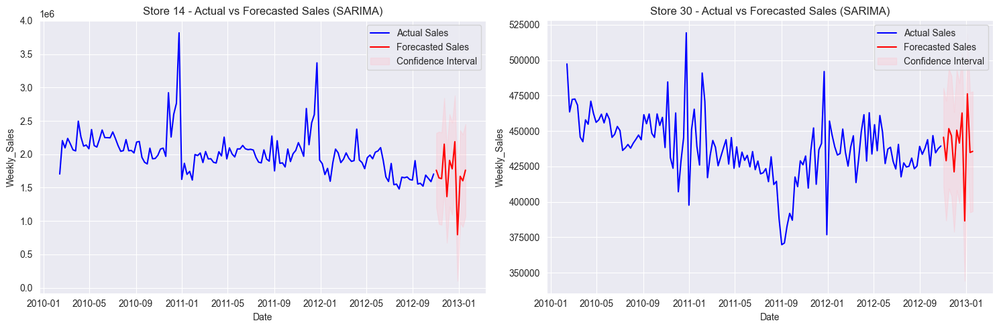

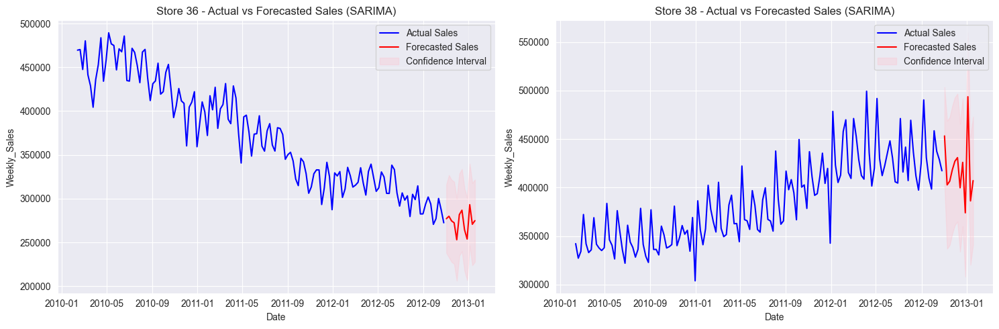

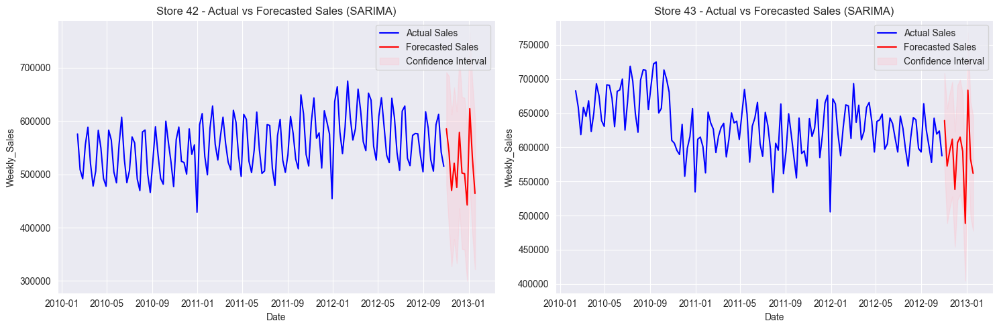

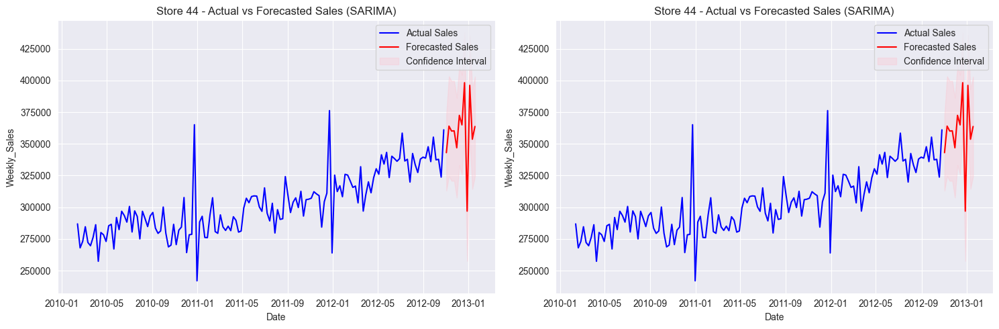

In [60]:
stores = non_stationary_combined_df['Store'].unique()
for i in range(0, len(stores), 2):
    store_id_1 = stores[i]
    store_id_2 = stores[i + 1] if i + 1 < len(stores) else stores[i]
    plot_store_forecast(store_id_1, store_id_2,non_stationary_df, sarimax_result)

In [61]:
def calculate_accuracy_sarima_stationary_non(non_stationary_df, period):
    stores = non_stationary_df['Store'].unique()
    accuracy_metrics = pd.DataFrame(columns=['Store', 'RMSE', 'MAE', 'MAPE'])

    for store_id in stores:
        store_data = non_stationary_df[non_stationary_df['Store'] == store_id]
        store_data['Date'] = pd.to_datetime(store_data['Date'], format='%Y-%m-%d')

        model = sm.tsa.statespace.SARIMAX(store_data['Diff_Weekly_Sales'], order=(0, 0, 1), seasonal_order=(1, 0, 0, 52))
        results = model.fit()

        forecast = results.get_forecast(steps=period)

        last_sales = store_data['Weekly_Sales'].iloc[-1]
        forecast_value = forecast.predicted_mean + last_sales

        actual_sales = store_data['Weekly_Sales'].tail(period)  # Assuming the last 12 weeks are for evaluation

        rmse = mean_squared_error(actual_sales, forecast_value)
        mae = mean_absolute_error(actual_sales, forecast_value)
        mape = mean_absolute_percentage_error(actual_sales, forecast_value)

        accuracy_metrics = accuracy_metrics.append({
            'Store': store_id,'RMSE': rmse,
            'MAE': mae,'MAPE': mape}, ignore_index=True)

    return accuracy_metrics

In [62]:
non_st_12 = calculate_accuracy_sarima_stationary_non(non_stationary_df,12)
non_st_24 = calculate_accuracy_sarima_stationary_non(non_stationary_df,24)
non_st_48 = calculate_accuracy_sarima_stationary_non(non_stationary_df,48)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### Now forecast for remaining stores.

In [63]:
test_order(walmart_df, 20)

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,1)[52] intercept   : AIC=inf, Time=5.68 sec
 ARIMA(0,0,0)(0,0,0)[52] intercept   : AIC=-213.795, Time=0.04 sec
 ARIMA(1,0,0)(1,0,0)[52] intercept   : AIC=-261.969, Time=3.33 sec
 ARIMA(0,0,1)(0,0,1)[52] intercept   : AIC=inf, Time=2.25 sec
 ARIMA(0,0,0)(0,0,0)[52]             : AIC=1173.697, Time=0.00 sec
 ARIMA(1,0,0)(0,0,0)[52] intercept   : AIC=-237.551, Time=0.07 sec
 ARIMA(1,0,0)(2,0,0)[52] intercept   : AIC=-274.233, Time=37.52 sec
 ARIMA(1,0,0)(2,0,1)[52] intercept   : AIC=-289.671, Time=34.14 sec
 ARIMA(1,0,0)(1,0,1)[52] intercept   : AIC=inf, Time=5.02 sec
 ARIMA(1,0,0)(2,0,2)[52] intercept   : AIC=inf, Time=42.93 sec
 ARIMA(1,0,0)(1,0,2)[52] intercept   : AIC=inf, Time=35.35 sec
 ARIMA(0,0,0)(2,0,1)[52] intercept   : AIC=inf, Time=57.83 sec
 ARIMA(2,0,0)(2,0,1)[52] intercept   : AIC=-292.347, Time=83.23 sec
 ARIMA(2,0,0)(1,0,1)[52] intercept   : AIC=-293.613, Time=4.14 sec
 ARIMA(2,0,0)(0,0,1)[52] intercept   : AIC=

**The identified common order in all stores for the SARIMAX model is (0, 0, 0)(1, 1, 0)[52].**

- This notation represents the model's parameters:
    - (0, 0, 0) refers to the ARIMA components:
        - 0 for the autoregressive (AR) component.
        - 0 for the differencing (I) component.
        - 0 for the moving average (MA) component.
        
    - (1, 1, 0) represents the seasonal components:
        - 1 for the seasonal autoregressive (SAR) component.
        - 1 for the seasonal differencing (SI) component.
        - 0 for the seasonal moving average (SMA) component.
        - [52] denotes the seasonal periodicity, indicating the data's seasonality occurs over a span of 52 time periods (weeks in this case).
**This configuration, derived as the common pattern across all stores, serves as the basis parameters for the SARIMAX model to  forecast the time series data for all stores.**

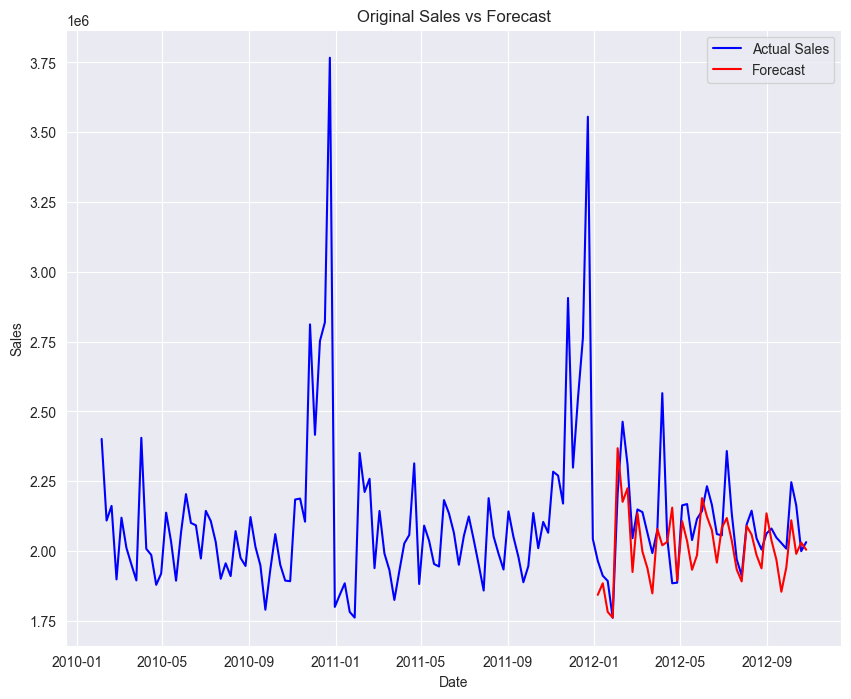

In [64]:
store1 = walmart_df[walmart_df['Store'] == 20]
model = SARIMAX(store1['Log_Weekly_Sales'], order=(0, 0, 0), seasonal_order=(1, 1, 0,52))
results = model.fit()
store1['forecast'] = results.predict(start=100, end=142, dynamic=True)    
plt.figure(figsize=(10, 8))
store1['Log_Weekly_Sales'] = np.exp(store1['Log_Weekly_Sales'])
store1['forecast'] = np.exp(store1['forecast'])
plt.plot(store1['Date'], store1['Weekly_Sales'], label='Actual Sales', color='blue')
plt.plot(store1['Date'], store1['forecast'], label='Forecast', color='red')
plt.title('Original Sales vs Forecast')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.legend()
plt.grid(True)
plt.show()

In [65]:
def calculate_accuracy_sarima_stationary(dataframe, period):
    stores = dataframe['Store'].unique()
    accuracy_metrics = pd.DataFrame(columns=['Store', 'RMSE', 'MAE', 'MAPE'])

    for store_id in stores:
        store_data = dataframe[dataframe['Store'] == store_id]
        model = SARIMAX(store_data['Log_Weekly_Sales'], order=(0, 0, 0), seasonal_order=(1, 1, 0, 52))
        results = model.fit()
        forecast = results.get_forecast(steps=period)
        forecasted_values = np.exp(forecast.predicted_mean)

        actual_sales = np.exp(store_data['Log_Weekly_Sales'].tail(period))  # Assuming the last 43 weeks for evaluation

        rmse = mean_squared_error(actual_sales, forecasted_values)
        mae = mean_absolute_error(actual_sales, forecasted_values)
        mape = mean_absolute_percentage_error(actual_sales, forecasted_values)

        accuracy_metrics = accuracy_metrics.append({
            'Store': store_id,
            'RMSE': rmse,
            'MAE': mae,
            'MAPE': mape
        }, ignore_index=True)

    return accuracy_metrics

In [66]:
st_12 = calculate_accuracy_sarima_stationary(walmart_df,12)
st_24 = calculate_accuracy_sarima_stationary(walmart_df,24)
st_48 = calculate_accuracy_sarima_stationary(walmart_df,48)

In [67]:
sarima_12 = pd.concat([non_st_12, st_12], axis=0)
sarima_12.reset_index(drop=True, inplace=True)
sarima_24 = pd.concat([non_st_24, st_24], axis=0)
sarima_24.reset_index(drop=True, inplace=True)
sarima_48 = pd.concat([non_st_48, st_48], axis=0)
sarima_48.reset_index(drop=True, inplace=True)

In [68]:
def sales_forecast(walmart_df, periods):
    stores = walmart_df['Store'].unique()
    sarimax_result = pd.DataFrame(columns=['Store', 'Date', 'Forecasted_Sales', 'Lower_Limit', 'Upper_Limit'])  # Initialize DataFrame to store results

    for store_id in stores:
        # Filter data for the specific store
        store_data = walmart_df[walmart_df['Store'] == store_id]
        store_data['Date'] = pd.to_datetime(store_data['Date'], format = '%d-%m-%Y')
        model = sm.tsa.statespace.SARIMAX(store_data['Log_Weekly_Sales'], order=(0, 0, 0), seasonal_order=(0, 1, 1, 52))
        results = model.fit()
        last_date = store_data['Date'].max()
        next_weeks = pd.date_range(start=pd.to_datetime(last_date) + pd.DateOffset(weeks=1), periods=periods, freq='W-FRI')
        new_dates_df = pd.DataFrame({'Date': next_weeks})

        df_combined = pd.concat([store_data.set_index('Date'), new_dates_df.set_index('Date')])
        df_combined.reset_index(inplace=True)

        forecast_results = results.get_forecast(steps=periods)
        forecast_values = forecast_results.predicted_mean
        confidence_intervals = forecast_results.conf_int()
        
        temp_df = pd.DataFrame({
            'Store': [store_id] * periods,'Date': df_combined['Date'].tail(periods),
            'Forecasted_Sales': forecast_values,
            'Lower_Limit': confidence_intervals.iloc[:, 0].values,
            'Upper_Limit': confidence_intervals.iloc[:, 1].values})
        sarimax_result = pd.concat([sarimax_result, temp_df], ignore_index=True)
    return sarimax_result

In [69]:
forecasted_sales_all_stores = sales_forecast(walmart_df, periods=12)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [70]:
forecasted_sales_all_stores.rename(columns = {'Forecasted_Sales': 'Weekly_Sales'}, inplace = True)
forecasted_sales_all_stores['Weekly_Sales'] = np.exp(forecasted_sales_all_stores['Weekly_Sales'])
forecasted_sales_all_stores['Lower_Limit'] = np.exp(forecasted_sales_all_stores['Lower_Limit'])
forecasted_sales_all_stores['Upper_Limit'] = np.exp(forecasted_sales_all_stores['Upper_Limit'])

In [71]:
forecasted_sales_all_stores.head()

,Store,Date,Weekly_Sales,Lower_Limit,Upper_Limit
0,1,2012-11-02,1.737338e+06,1.565194e+06,1.928415e+06
1,1,2012-11-09,1.622196e+06,1.461461e+06,1.800609e+06
2,1,2012-11-16,1.554332e+06,1.400321e+06,1.725281e+06
3,1,2012-11-23,2.054060e+06,1.850534e+06,2.279970e+06
4,1,2012-11-30,1.593611e+06,1.435708e+06,1.768880e+06


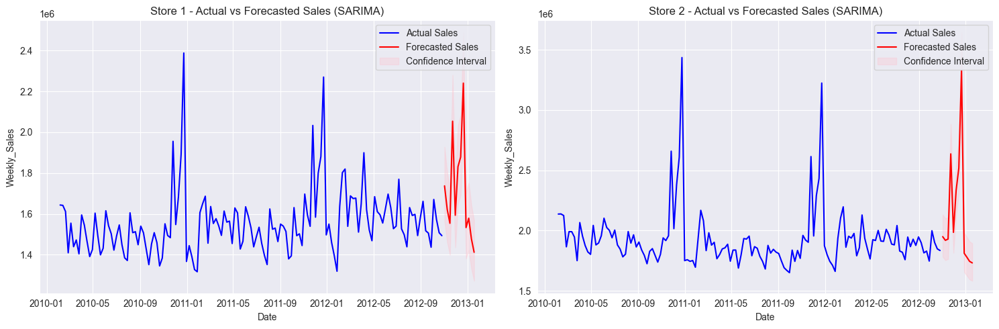

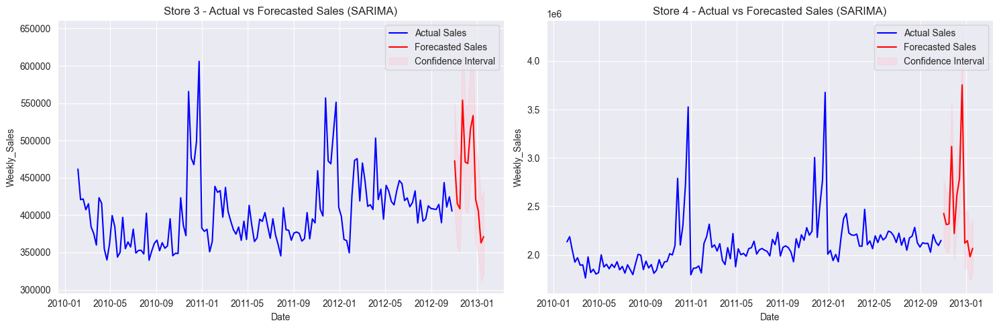

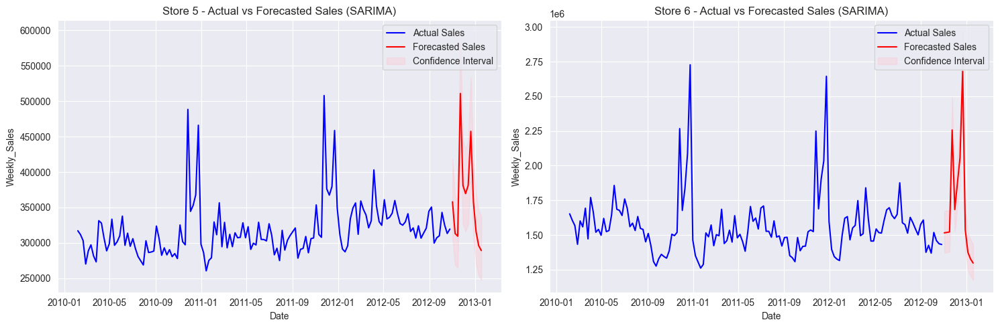

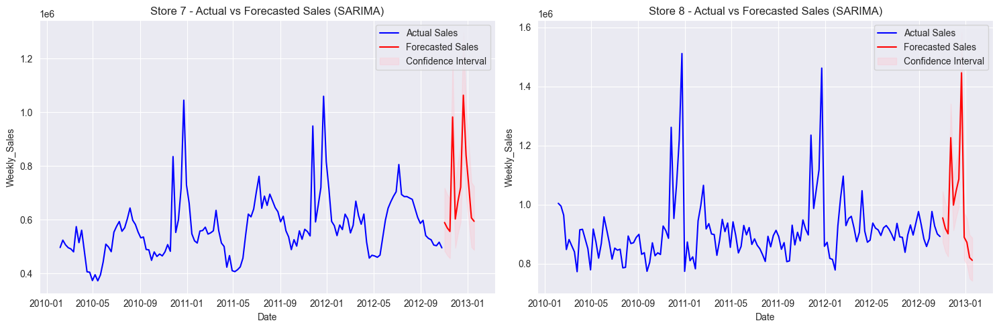

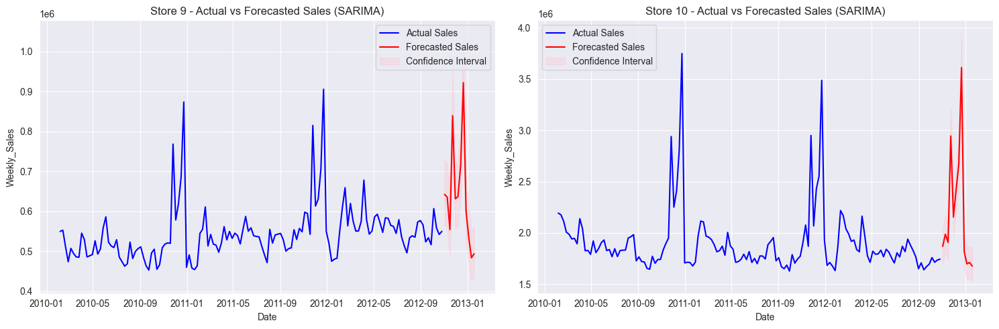

...

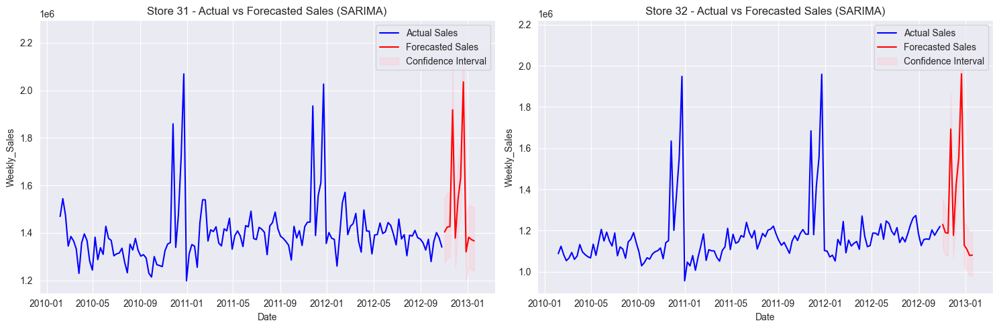

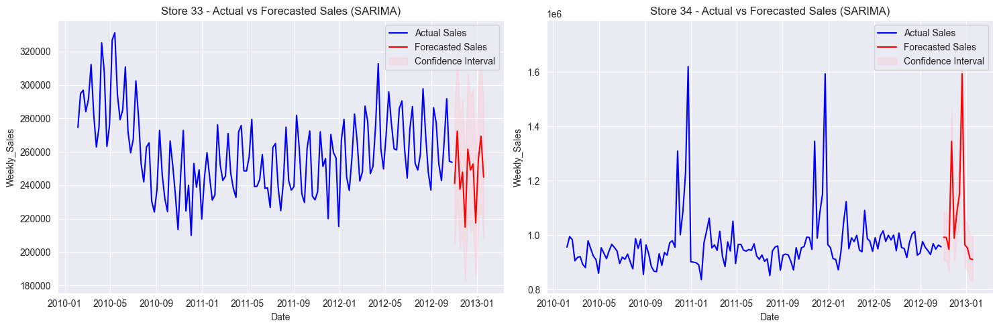

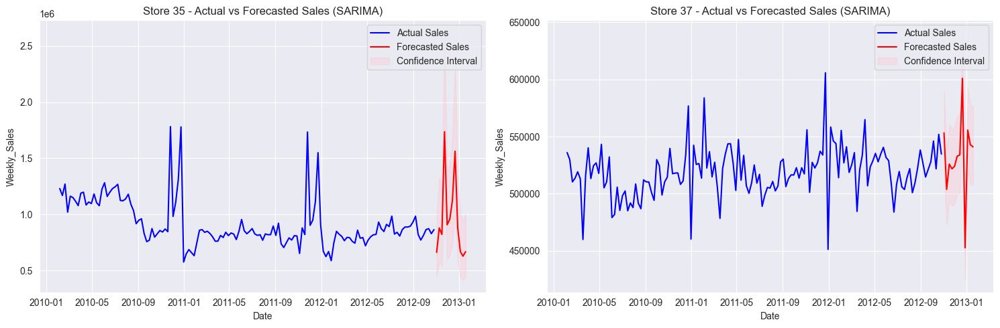

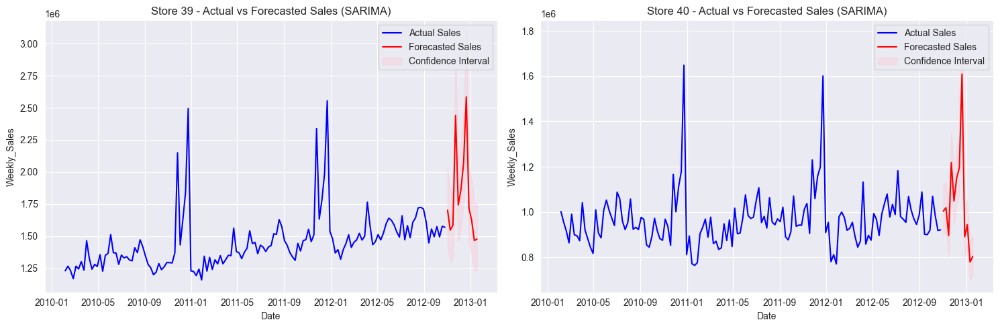

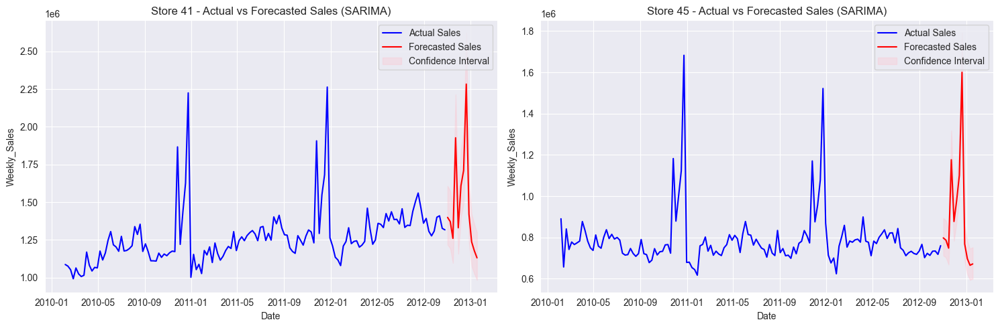

In [72]:
stores = walmart_df['Store'].unique()
for i in range(0, len(stores), 2):
    store_id_1 = stores[i]
    store_id_2 = stores[i + 1] if i + 1 < len(stores) else stores[i]
    plot_store_forecast(store_id_1, store_id_2,walmart_df, forecasted_sales_all_stores)

# Building FBprophet as it shows lowest mape

In [73]:
import logging
logging.getLogger('cmdstanpy').setLevel(logging.WARNING)

In [74]:
walmart_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6435 entries, 0 to 6434
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Store         6435 non-null   category      
 1   Date          6435 non-null   datetime64[ns]
 2   Weekly_Sales  6435 non-null   float64       
 3   Holiday_Flag  6435 non-null   category      
 4   Temperature   6435 non-null   float64       
 5   Fuel_Price    6435 non-null   float64       
 6   CPI           6435 non-null   float64       
 7   Unemployment  6435 non-null   float64       
 8   Year          6435 non-null   int64         
 9   Month         6435 non-null   int64         
 10  Day           6435 non-null   int64         
 11  Week          6435 non-null   UInt32        
dtypes: UInt32(1), category(2), datetime64[ns](1), float64(5), int64(3)
memory usage: 498.1 KB


In [75]:
walmart_df = walmart_data.copy()
walmart_df.drop(columns = ['Holiday_Flag','Temperature','Fuel_Price','CPI','Unemployment'], inplace = True)

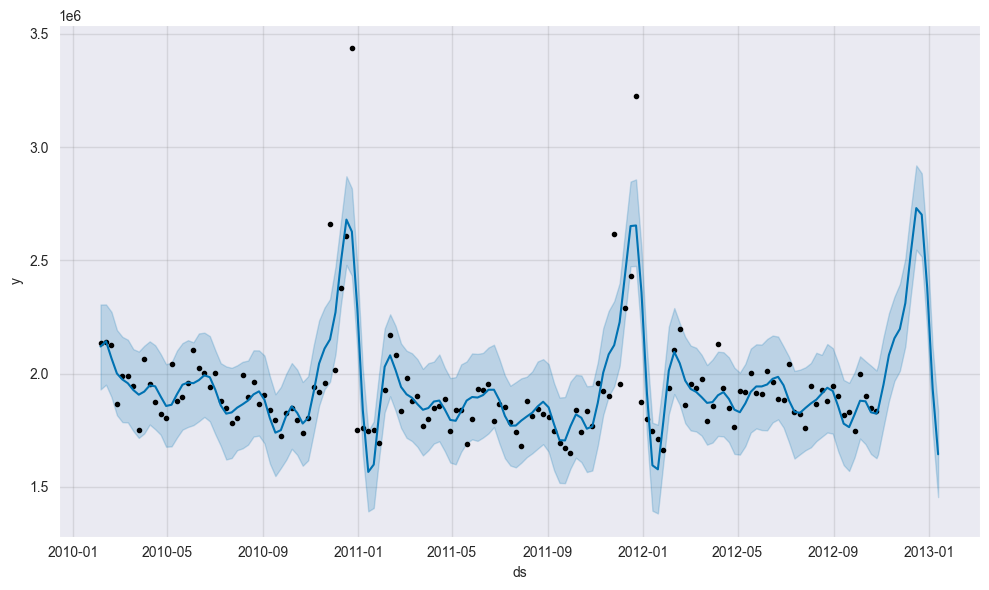

In [76]:
store1 = walmart_df[walmart_df['Store'] == 2]
sales_prophet =store1.rename(columns={'Date': 'ds', 'Weekly_Sales': 'y'})
us_holidays = {'Thanksgiving': {'date': '11-23', 'window': 2},'Christmas': {'date': '12-25', 'window': 1}}
holidays_df = pd.DataFrame({'holiday': list(us_holidays.keys()),'ds': pd.to_datetime([f"2012-{date['date']}" for date in us_holidays.values()])})
holidays_df['lower_window'] = -7 * holidays_df['holiday'].map({holiday: details['window'] for holiday, details in us_holidays.items()})
holidays_df['upper_window'] = 3
model = Prophet(holidays=holidays_df)
model.fit(sales_prophet)
future = model.make_future_dataframe(periods=12, freq='W') 
forecast = model.predict(future)
fig = model.plot(forecast)

In [77]:
model = Prophet()
model.fit(sales_prophet)
cv_results = cross_validation(model, initial='728 days', period='7 days', horizon='90 days')
metrics = performance_metrics(cv_results)
metrics = pd.DataFrame(metrics)
metrics

  0%|          | 0/26 [00:00<?, ?it/s]

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,13 days,1.492195e+10,122155.453458,89875.144673,0.045202,0.041621,0.046906,0.884615
1,20 days,1.336442e+10,115604.599191,85883.330279,0.043670,0.038135,0.045254,0.914918
2,27 days,1.311609e+10,114525.518501,86286.448786,0.043997,0.036799,0.045574,0.923077
3,34 days,1.333383e+10,115472.190224,86766.428017,0.044225,0.029827,0.045826,0.953380
4,41 days,1.394985e+10,118109.486457,88875.054594,0.045346,0.032573,0.047040,0.931235
5,48 days,1.352333e+10,116289.860458,89083.155338,0.045675,0.029590,0.047343,0.923077
6,55 days,1.448247e+10,120343.122492,91998.973153,0.047230,0.033878,0.049077,0.892774
7,62 days,1.521257e+10,123339.240977,92732.559989,0.047553,0.036545,0.049492,0.914918
8,69 days,1.292999e+10,113710.119753,90700.840347,0.046946,0.034989,0.048615,0.953380
9,76 days,1.189705e+10,109073.612904,89688.169102,0.046599,0.036156,0.048170,0.931235


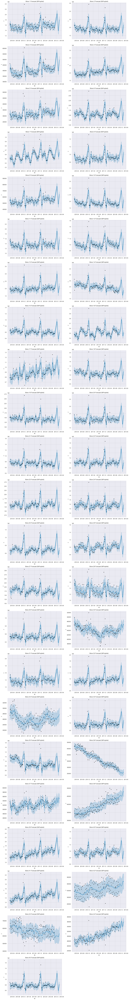

In [78]:
stores = walmart_df['Store'].unique()
num_plots = len(stores)
rows = (num_plots + 1) // 2
fig, axs = plt.subplots(rows, 2, figsize=(15, 5 * rows))
for i, store_id in enumerate(stores):
    row = i // 2  
    col = i % 2   
    store_data = walmart_df[walmart_df['Store'] == store_id].rename(columns={'Date': 'ds', 'Weekly_Sales': 'y'})
    model = Prophet(holidays=holidays_df)
    model.fit(store_data)
    forecast_period = 16  
    future = model.make_future_dataframe(periods=forecast_period, freq='W')
    forecast = model.predict(future)
    model.plot(forecast, ax=axs[row, col])
    axs[row, col].set_title(f"Store {store_id} Forecast (fbProphet)")
    
for i in range(len(stores), axs.size):
    axs.flatten()[i].axis('off')

plt.tight_layout()
plt.show()

In [79]:
def calculate_accuracy_pro(dataframe, holidays_df, forecast_horizon):
    grouped = dataframe.groupby('Store')
    store_ids = []
    rmse_list = []
    mae_list = []
    mape_list = []

    for store_id, group_data in grouped:
        df_prophet = group_data[['Date', 'Weekly_Sales']].rename(columns={'Date': 'ds', 'Weekly_Sales': 'y'})

        model = Prophet(holidays=holidays_df)
        model.fit(df_prophet)

        future = model.make_future_dataframe(periods=forecast_horizon, freq='W')
        forecast = model.predict(future)

        actual_values = df_prophet['y'].values
        predicted_values = forecast['yhat'].tail(len(actual_values)).values

        rmse = mean_squared_error(actual_values, predicted_values, squared=False)
        mae = mean_absolute_error(actual_values, predicted_values)
        mape = mean_absolute_percentage_error(actual_values, predicted_values)

        store_ids.append(store_id)
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)

    accuracy_df_prophet = pd.DataFrame({
        'Store': store_ids,
        'RMSE': rmse_list,
        'MAE': mae_list,
        'MAPE': mape_list
    })

    return accuracy_df_prophet

In [80]:
pro_acc_12 = calculate_accuracy_pro(walmart_df, holidays_df,13) #3 months
pro_acc_24 = calculate_accuracy_pro(walmart_df, holidays_df,26) #6 months
pro_acc_48 = calculate_accuracy_pro(walmart_df, holidays_df,52) #

## Exponential Smoothing

In [81]:
def calculate_accuracy_expo(df, store_column, sales_column, forecast_period):
    grouped = df.groupby(store_column)

    store_ids = []
    rmse_list = []
    mae_list = []
    mape_list = []

    for store_id, group_data in grouped:
        model = ExponentialSmoothing(group_data[sales_column], trend='add', seasonal='add', seasonal_periods=52).fit()

        forecast = model.forecast(steps=forecast_period)

        actual_sales = group_data[sales_column].iloc[-forecast_period:]

        rmse = mean_squared_error(actual_sales, forecast[:forecast_period], squared=False)
        mae = mean_absolute_error(actual_sales, forecast[:forecast_period])
        mape = mean_absolute_percentage_error(actual_sales, forecast[:forecast_period])

        store_ids.append(store_id)
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)

    accuracy_df = pd.DataFrame({
        'Store': store_ids,
        'RMSE': rmse_list,
        'MAE': mae_list,
        'MAPE': mape_list
    })

    return accuracy_df

In [82]:
expo_acc_12 = calculate_accuracy_expo(walmart_df, 'Store', 'Weekly_Sales',12)
expo_acc_24 = calculate_accuracy_expo(walmart_df, 'Store', 'Weekly_Sales',24)
expo_acc_48 = calculate_accuracy_expo(walmart_df, 'Store', 'Weekly_Sales',48)

In [83]:
grouped = walmart_df.groupby('Store')

store_ids = []
rmse_list = []
mae_list = []
mape_list = []

forecast_period = 20

for store_id, group_data in grouped:
    model = ExponentialSmoothing(group_data['Weekly_Sales'], trend = 'add',seasonal='add', seasonal_periods=52).fit()

    forecast = model.forecast(steps=forecast_period)

    actual_sales = group_data['Weekly_Sales'].iloc[-forecast_period:]

    rmse = mean_squared_error(actual_sales, forecast[:forecast_period], squared=False)
    mae = mean_absolute_error(actual_sales, forecast[:forecast_period])
    mape = mean_absolute_percentage_error(actual_sales, forecast[:forecast_period])
    
    store_ids.append(store_id)
    rmse_list.append(rmse)
    mae_list.append(mae)
    mape_list.append(mape)

accuracy_df_Exponential = pd.DataFrame({'Store': store_ids,
    'RMSE': rmse_list,'MAE': mae_list,'MAPE': mape_list})

In [84]:
accuracy_df_Exponential.head()

,Store,RMSE,MAE,MAPE
0,1,288358.519402,217437.749705,0.140306
1,2,492550.265087,322834.488071,0.172789
2,3,94408.856306,68966.885588,0.168175
3,4,491375.732247,318220.826070,0.148754
4,5,72238.954121,54023.876193,0.167946


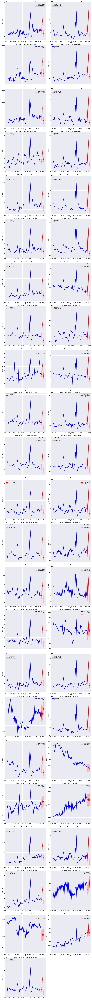

In [85]:
from scipy.stats import norm 
stores = walmart_df['Store'].unique()

forecasted_results = pd.DataFrame(columns=['Store', 'Date', 'Forecasted_Sales', 'Lower Limit', 'Upper Limit'])
forecasted_results['Date'] = pd.to_datetime(forecasted_results['Date'])
num_plots_per_row = 2
num_rows = (len(stores) + num_plots_per_row - 1) // num_plots_per_row
fig, axs = plt.subplots(num_rows, num_plots_per_row, figsize=(15, 7 * num_rows))

for i, store_id in enumerate(stores):
    row = i // num_plots_per_row
    col = i % num_plots_per_row
    ax = axs[row, col] if num_rows > 1 else axs[col]
    
    store_data = walmart_df[walmart_df['Store'] == store_id]
    model = ExponentialSmoothing(store_data['Weekly_Sales'], trend='add', seasonal='add', seasonal_periods=52).fit()
    forecast = model.forecast(steps=12)
    alpha = 0.05  
    forecast_std = model.resid.std()  
    z_critical = norm.ppf(1 - alpha / 2)  
    lower_limit = forecast - z_critical * forecast_std
    upper_limit = forecast + z_critical * forecast_std
    
    forecast_dates = pd.date_range(start=store_data['Date'].max(), periods=12, freq='W-FRI')
    forecast_df = pd.DataFrame({'Store': [store_id] * 12,
        'Date': forecast_dates, 'Forecasted_Sales': forecast,
        'Lower Limit': lower_limit,'Upper Limit': upper_limit})
    
    forecasted_results = pd.concat([forecasted_results, forecast_df], ignore_index=True)
    
    ax.plot(store_data['Date'], store_data['Weekly_Sales'], label='Actual Sales', color='blue')
    ax.plot(forecast_dates, forecast, label='Forecasted Sales', color='red')
    ax.fill_between(forecast_dates, lower_limit, upper_limit, color='red', alpha=0.2, label='Prediction Interval')
    ax.set_title(f'Store {store_id} Sales Forecast (ExponentialSmoothing)')
    ax.set_xlabel('Date')
    ax.set_ylabel('Weekly Sales')
    ax.legend()
    ax.grid(True)

if len(stores) % num_plots_per_row != 0:
    for i in range(len(stores), num_rows * num_plots_per_row):
        row = i // num_plots_per_row
        col = i % num_plots_per_row
        axs[row, col].axis('off')

plt.tight_layout()
plt.show()


In [86]:
concatenated_df = pd.concat([walmart_df, forecasted_results], axis=0)
concatenated_df.reset_index(drop=True, inplace=True)
concatenated_df.drop(columns= ['Year', 'Month', 'Day', 'Week'], axis = 1, inplace = True)

In [87]:
concatenated_df.tail()

,Store,Date,Weekly_Sales,Forecasted_Sales,Lower Limit,Upper Limit
6970,45,2012-12-14,NaN,1.664199e+06,1.580874e+06,1.747524e+06
6971,45,2012-12-21,NaN,7.230380e+05,6.397129e+05,8.063631e+05
6972,45,2012-12-28,NaN,6.949588e+05,6.116337e+05,7.782839e+05
6973,45,2013-01-04,NaN,6.663910e+05,5.830659e+05,7.497161e+05
6974,45,2013-01-11,NaN,6.618449e+05,5.785198e+05,7.451700e+05


### Checking each models performance to finalize a model

- We'll compute a weighted Mean Absolute Percentage Error (MAPE) to evaluate the accuracy of our sales forecasting model for different stores. 
- We assign 'store weights' based on the weekly sales data from our dataset. These weights represent the relative importance of each store's sales figures in our accuracy assessment. 
- Stores with higher sales volumes carry more weight in the calculation, meaning they have a greater influence on the overall accuracy metric. By using these store-specific weights along with the MAPE values derived from our forecasting model ('accuracy_metrics_sarima'), we obtain a weighted MAPE. 
- This metric accounts for the varying contributions of different stores to our assessment, offering a more nuanced evaluation of forecast accuracy across our retail locations.

In [88]:
walmart_df = walmart_data.copy()
store_weights = walmart_df.set_index('Store')['Weekly_Sales']
def calculate_weighted_mape(model_acc, store_weights):
    weighted_mape = (model_acc['MAPE'] * store_weights).sum() / store_weights.sum()
    return weighted_mape * 100
weighted_mape_exponential_12 = calculate_weighted_mape(expo_acc_12, store_weights)
weighted_mape_sarima_12 = calculate_weighted_mape(sarima_12, store_weights)
weighted_mape_prophet_12 = calculate_weighted_mape(pro_acc_12, store_weights)
# For 24 weeks
weighted_mape_exponential_24 = calculate_weighted_mape(expo_acc_24, store_weights)
weighted_mape_sarima_24 = calculate_weighted_mape(sarima_24, store_weights)
weighted_mape_prophet_24 = calculate_weighted_mape(pro_acc_24, store_weights)
# For 48 weeks
weighted_mape_exponential_48 = calculate_weighted_mape(expo_acc_48, store_weights)
weighted_mape_sarima_48 = calculate_weighted_mape(sarima_48, store_weights)
weighted_mape_prophet_48 = calculate_weighted_mape(pro_acc_48, store_weights)

In [89]:
model_performance = pd.DataFrame(columns=['Model', 'Time(In weeks)', 'Weighted MAPE'])

def add_result_to_df(model_name, time_period, weighted_mape):
    global model_performance
    model_performance = model_performance.append({'Model': model_name,'Time(In weeks)': time_period,
        'Weighted MAPE': weighted_mape}, ignore_index=True)
    
# For 12 weeks
add_result_to_df("Prophet model", 12, weighted_mape_prophet_12)
add_result_to_df("Exponential Smoothing", 12, weighted_mape_exponential_12)
add_result_to_df("SARIMA", 12, weighted_mape_sarima_12)
# For 24 weeks
add_result_to_df("Prophet model", 24, weighted_mape_prophet_24)
add_result_to_df("Exponential Smoothing", 24, weighted_mape_exponential_24)
add_result_to_df("SARIMA", 24, weighted_mape_sarima_24)
# For 48 weeks
add_result_to_df("Prophet model", 48, weighted_mape_prophet_48)
add_result_to_df("Exponential Smoothing", 48, weighted_mape_exponential_48)
add_result_to_df("SARIMA", 48, weighted_mape_sarima_48)

In [90]:
model_performance

,Model,Time(In weeks),Weighted MAPE
0,Prophet model,12,12.359774
1,Exponential Smoothing,12,22.383166
2,SARIMA,12,19.493859
3,Prophet model,24,11.277636
4,Exponential Smoothing,24,13.493857
5,SARIMA,24,12.231114
6,Prophet model,48,7.318343
7,Exponential Smoothing,48,12.259236
8,SARIMA,48,11.017743


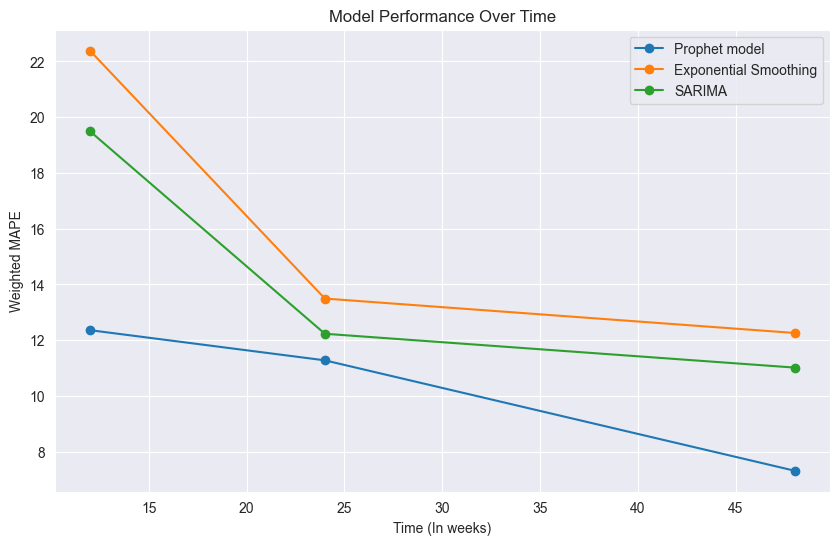

In [91]:
prophet_data = model_performance[model_performance['Model'] == 'Prophet model']
exp_smooth_data = model_performance[model_performance['Model'] == 'Exponential Smoothing']
sarima_data = model_performance[model_performance['Model'] == 'SARIMA']

plt.figure(figsize=(10, 6))

plt.plot(prophet_data['Time(In weeks)'], prophet_data['Weighted MAPE'], marker='o', label='Prophet model')
plt.plot(exp_smooth_data['Time(In weeks)'], exp_smooth_data['Weighted MAPE'], marker='o', label='Exponential Smoothing')
plt.plot(sarima_data['Time(In weeks)'], sarima_data['Weighted MAPE'], marker='o', label='SARIMA')

plt.xlabel('Time (In weeks)')
plt.ylabel('Weighted MAPE')
plt.title("Model Performance Over Time")
plt.legend()
plt.grid(True)
plt.show()

- Lower MAPE Values: Across all time periods (12, 24, and 48 weeks), the Prophet model consistently demonstrates the lowest Weighted MAPE compared to Exponential Smoothing and SARIMA. Lower MAPE indicates better accuracy in predicting sales.

- Consistency: The Prophet model maintains a relatively lower MAPE across different time spans, suggesting it's more robust and consistent in forecasting sales compared to the other models.

- Stability Over Time: The Prophet model shows stable and consistently lower errors even as the forecasting horizon extends to 48 weeks, which is advantageous when making long-term predictions.

- Ease of Use: The Prophet model is designed for simpler implementation, requiring fewer hyperparameters to tune compared to SARIMA, which often demands expertise in time series modeling and analysis.

**Lower values of weighted MAPE indicate better accuracy, so based on these calculations, the Prophet model appears to have the best performance in forecasting weekly sales across the stores in your dataset, followed by the SARIMA model and then the Exponential Smoothing model.**

In [92]:
def plot_forecasts(df, forecast_period):
    def create_holidays(store_data):
        us_holidays = {
            'Thanksgiving': {'date': '11-23', 'window': 2},
            'Christmas': {'date': '12-25', 'window': 1}
        }
        holidays_df = pd.DataFrame({
            'holiday': list(us_holidays.keys()),
            'ds': pd.to_datetime([f"2012-{date['date']}" for date in us_holidays.values()])
        })
        holidays_df['lower_window'] = -7 * holidays_df['holiday'].map({holiday: details['window'] for holiday, details in us_holidays.items()})
        holidays_df['upper_window'] = 3
        return holidays_df
    stores = df['Store'].unique()
    stores_with_data = [store_id for store_id in stores if len(df[df['Store'] == store_id]) >= forecast_period]
    num_plots = len(stores_with_data)
    rows = (num_plots + 1) // 2  
    fig, axs = plt.subplots(rows, 2, figsize=(15, 5 * rows))  
    for i, store_id in enumerate(stores_with_data):
        row = i // 2  # Calculate subplot row
        col = i % 2   # Calculate subplot column
        store_data = df[df['Store'] == store_id].rename(columns={'Date': 'ds', 'Weekly_Sales': 'y'})
        holidays_df = create_holidays(store_data)
        model = Prophet(holidays=holidays_df)
        model.fit(store_data)
        future = model.make_future_dataframe(periods=forecast_period, freq='W')
        forecast = model.predict(future)
        model.plot(forecast, ax=axs[row, col])
        axs[row, col].set_title(f"Store {store_id}")
    for i in range(num_plots, rows * 2):
        axs.flatten()[i].axis('off')
    plt.xlabel('Date')
    plt.ylabel('Sales Forcast')
    plt.tight_layout()
    plt.show()

# Future Possibilities of the Project:
- **Leveraging Additional Data for Improved Accuracy:** Access to more extensive datasets can significantly enhance accuracy. Supplementing the existing data can refine forecasting models and capture nuanced patterns, leading to more precise predictions.

- **Refinement of SARIMA Model Parameters for All Stores:** The pursuit of optimal parameters specific to each store for the SARIMA model can enhance its predictive capabilities. Fine-tuning parameters tailored to individual store dynamics can lead to more accurate and personalized forecasts.

- **Incorporating Additional Holidays in FBprophet Model:** Integrating a broader spectrum of holidays into the FBprophet model can enhance its predictive capacity. Accounting for more holidays, especially those significant to the stores or regions, enables the model to capture fluctuations and seasonal variations tied to these events, enriching forecast accuracy.

- **Real-time Dashboard: Developing a real-time:** dashboard to visualize the predicted versus actual sales, key performance indicators, and relevant metrics could assist stakeholders in making informed decisions promptly. This would enable quick reactions to emerging trends or anomalies.

**Continued development in these areas can fortify the project's predictive power and versatility, enabling more robust and reliable forecasting across multiple models and store contexts.**

# Conclusion and Results:

## **If the weekly sales are affected by the unemployment rate, if yes - which stores are suffering the most?**
   - Impact of Unemployment on Store Sales: Analysis of correlation values reveals a compelling trend between unemployment rates and weekly sales across stores. The negative correlations, such as Store 38 (-0.785), Store 39 (-0.3846), and Store 44 (-0.780), signify a substantial inverse relationship. This indicates that as unemployment rates rise, weekly sales tend to decrease. Among these, Store 38 stands out with a notably high negative correlation, implying a heightened vulnerability to fluctuations in unemployment rates
   - Rest of the stores have very weak to correlation with Unemployment.

In [93]:
print("Top 5 Stores Most Affected by Unemployment Rate:")
print(top_affected_stores[['Store', 'Unemployment']])

Top 5 Stores Most Affected by Unemployment Rate:
   Store  Unemployment
37    38     -0.785290
43    44     -0.780076
38    39     -0.384681
41    42     -0.356355
40    41     -0.350630


## **If the weekly sales show a seasonal trend, when and what could be the reason?**
   - Average Sales During Holidays: 1122887.8923555557
   - Average Sales During Non-Holidays: 1041256.3802088555
   - **General Seasonal Patterns:** A comprehensive evaluation of weekly sales patterns across stores reveals a prevalent seasonal trend in most establishments, with the exception of Stores 28, 30, 33, 36, 37, 38, 42, and 43. These anomalies suggest distinctive sales behaviors in these specific stores that diverge from the observed seasonal patterns evident in others.
   - **Seasonal Peaks around Thanksgiving and Christmas:** A detailed examination of sales data unearthed a consistent yearly surge in sales occurring notably during November and December. This surge coincides with the Thanksgiving and Christmas periods. The distinctive peaks during these festive seasons signify a surge in consumer spending, aligning with traditional holiday shopping behaviors and the cultural significance of these celebratory periods.


## **Does temperature affect the weekly sales in any manner?**
   - **Temperature and Weekly Sales Relationship:** A meticulous examination of the relationship between temperature fluctuations and weekly sales from the presented graphs reveals that variations in temperature exhibit minimal, if any, discernible impact on weekly sales. The observed graphs depict a lack of consistent or substantial changes in weekly sales corresponding to temperature fluctuations. As temperatures rise or fall, there is no distinct pattern indicating a significant influence on the recorded weekly sales data.

   - **Limited Correlation Significance:** The correlation analysis conducted substantiates the graphical observations, highlighting that the correlation between temperature and weekly sales is notably weak. This weak correlation lacks the strength required to confidently assert that temperature fluctuations exert a substantial effect on weekly sales within this dataset.

   - **Sales Peaks During Festive Seasons:** Further examination indicates that the pronounced peaks in sales, aligning with Thanksgiving and Christmas periods, remain dominant. These peaks signify heightened consumer spending during these festive occasions, overshadowing any potential impact that temperature fluctuations might have on weekly sales

#### Summary:
The analysis strongly suggests that temperature fluctuations do not significantly influence the observed weekly sales trends. The substantial sales peaks coinciding with Thanksgiving and Christmas holidays emerge as the primary drivers of sales variations, overshadowing any discernible impact attributed to temperature changes within this dataset.

## **How is the Consumer Price index affecting the weekly sales of various stores?**
- Stores with Positive CPI Coefficients:
    - These stores show an increase in weekly sales with an increase in CPI.
    - Stores like 1, 3, 5, 7, 8, 9, 11, 12, 13, 16, 23, 26, 31, 34, 37, 40, 43, and 45 have positive coefficients for CPI, suggesting that as the Consumer Price Index rises, these stores tend to experience higher weekly sales.
- Stores with Negative CPI Coefficients:
    - These stores exhibit a decrease in weekly sales as the CPI increases.
    - Stores like 2, 4, 6, 10, 14, 15, 17, 18, 19, 20, 21, 22, 24, 25, 27, 28, 29, 30, 32, 33, 35, 36, 38, 39, 41, 42, and 44 have negative coefficients for CPI, indicating that their sales tend to decrease as the Consumer Price Index goes up.

- **Interpretation:**
- Stores with positive coefficients may be more aligned with consumer behavior where higher CPI implies more spending capacity or an increased willingness to purchase.
- Stores with negative coefficients might cater to products or demographics that are more sensitive to price changes, so an increase in CPI might deter their sales due to reduced purchasing power or consumer preferences shifting towards cheaper alternatives.

**This analysis suggests that the impact of CPI on weekly sales varies among stores, indicating different consumer behaviors, product categories, or market segments that respond differently to changes in the Consumer Price Index.**


## **Top performing stores according to the historical data.**


In [94]:
top_stores_by_total_sales.head(10)

Store
20    3.013978e+08
4     2.995440e+08
14    2.889999e+08
13    2.865177e+08
2     2.753824e+08
10    2.716177e+08
27    2.538559e+08
6     2.237561e+08
1     2.224028e+08
39    2.074455e+08
Name: Weekly_Sales, dtype: float64

## **The worst performing store, and how significant is the difference between the highest and lowest performing stores.**


In [95]:
print(f"Worst Performing Store by Total Sales: Store {worst_store_total_sales} with total sales of {min_sales_value}")

Worst Performing Store by Total Sales: Store 33 with total sales of 37160221.96


In [96]:
print(f"Difference between Highest and Lowest Total Sales: {difference_highest_lowest}")

Difference between Highest and Lowest Total Sales: 264237570.49999997


- The analysis reveals that Store 33 stands as the worst-performing store in terms of total sales, amassing a total of 37,160,221.96. On the opposite end of the spectrum, Store 20 emerges as the best-performing store, boasting the highest total sales among all stores, totaling 301,397,792.46.

- The disparity between these two extremes in sales performance is substantial, showcasing a remarkable difference of approximately 264,237,570.50. This significant contrast underscores the varied performances among stores, with the highest-performing store eclipsing the worst-performing one by a considerable margin.

## **Use predictive modeling techniques to forecast the sales for each store for the next x weeks**

#### Please Note:
- Given that a typical month roughly consists of 4.345 weeks or approximately 30-31 days on average (varying due to different month lengths).
- To account for these variations and achieve better accuracy in the forecast, we multiply the number of months by 4.345.
- This multiplication allows us to estimate the forecast period in terms of weeks (as 4 weeks equals approximately 28 days) for an 8-month period accurately.

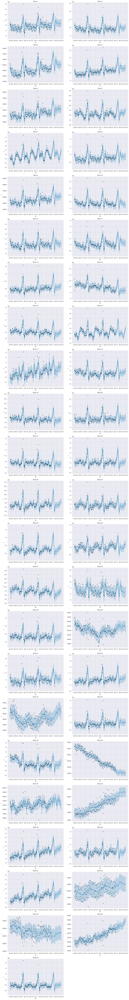

In [97]:
# Enter forecast period in weeks.
# Eg. for 8 months: 8*4.345 = 34.80. rounding off to 35.
plot_forecasts(walmart_df, forecast_period=35)

<h3 style="color: #800080">References:</h3>

- Sklearn Documentation: (https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html)
- ARIMA/SARIMA Documentation: (https://www.statsmodels.org/dev/generated/statsmodels.tsa.statespace.sarimax.SARIMAX.html)
- FBprophet Documentation: (https://facebook.github.io/prophet/docs/quick_start.html)
- Exponential Smoothing Documentation: (https://www.statsmodels.org/dev/generated/statsmodels.tsa.holtwinters.ExponentialSmoothing.html)